## Kaggle Diabetic Retinopathy Detection, предобработка изображений (2) &mdash; выделение диска, пятен, сосудов

### Севастопольский Артем

In [2]:
import os
import glob
import cv2
import bisect
from collections import deque, defaultdict
from math import sqrt
import numpy as np
import scipy as sp
from scipy import ndimage as ndi
import pandas as pd
import sklearn
import sklearn.cluster, sklearn.preprocessing, sklearn.decomposition
import skimage
import skimage.morphology, skimage.filters, skimage.feature, \
    skimage.segmentation, skimage.color
import mahotas as mh
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline
from joblib import Parallel, delayed
from numba import jit
# my libraries that deal with images and this data set specifically:
from imhandle import load_image, save_image, show_image, rmse, \
    normalize_image, load_set, rgb_to_grayscale, pxl_distr, plot_subfigures, \
    image_names_in_folder
from retina_im_lib import crop_black_border, prepare_img, expand, \
    bfs_clustered, erase_clusters, cluster_sizes, get_clusters, \
    get_clusters_from_img_set, leave_segments
from cluster_features import cl_areas, cl_centroids, cl_circularity, \
    cl_eccentricity, borders
from objects_detection import detect_vessels_1, exudate_detect_1, \
    optic_disk_fit, optic_disk_detect

In [3]:
os.path.abspath(os.curdir)

'/home/artem/Programming/Kaggle tasks/Retinopathy/scripts'

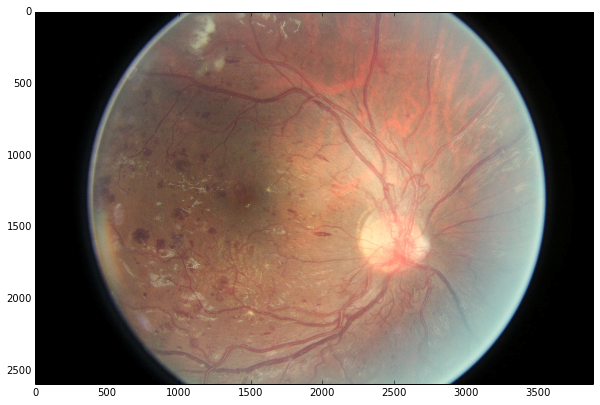

In [4]:
img = load_image('../data/sample/16_left.jpeg')
show_image(img)

Разрешение изображения очень высокое, снизим его.

Current shape:  (2592, 3888, 3)
New shape:  (518, 777, 3)


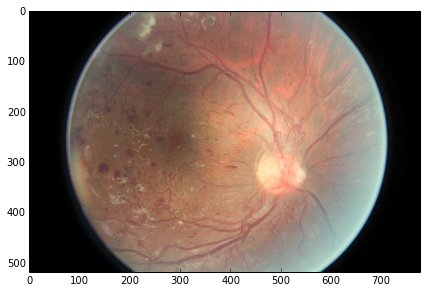

In [5]:
print 'Current shape: ', img.shape
#img = sp.misc.imresize(img, 0.2)
img = sp.misc.imresize(img, (518, 777))
show_image(img, fig_size=(7, 7))
print 'New shape: ', img.shape

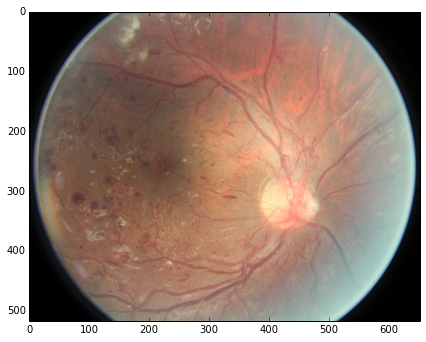

In [6]:
img = crop_black_border(img)
show_image(img, fig_size=(7, 7))

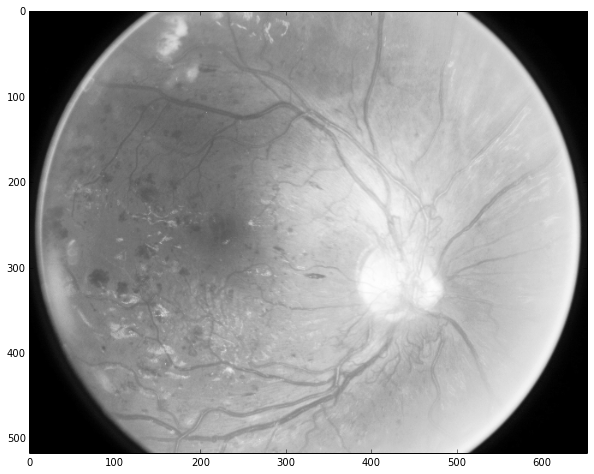

In [7]:
gb = rgb_to_grayscale(img)
gb = gb.astype('uint8')
show_image(gb, fig_size=(10,10))

### Распознавание диска

In [7]:
def disk(gb, ztol=8):
    # This algo performs flood filling from corners of the image.
    # Algo has a demerit: it depends on zero tolerance of `expand` function.
    
    # Flood filling
    h, w = gb.shape
    mask = np.full(gb.shape, -1, dtype=int)
    mask[0, 0] = mask[0, -1] = mask[-1, 0] = mask[-1, -1] = 0
    expand(gb, mask, 0, 0, 0, tol=ztol)
    expand(gb, mask, h - 1, 0, 0, tol=ztol)
    expand(gb, mask, 0, w - 1, 0, tol=ztol)
    expand(gb, mask, h - 1, w - 1, 0, tol=ztol)

    mask[mask == -1] = 255
    # Smoothing borders
    disk = mh.median_filter(mask, Bc=np.ones((5, 5)))
    return disk


def disk_border(gb, ztol=8):
    _disk = disk(gb, ztol)
    _disk_border = mh.laplacian_2D(_disk)
    _disk_border = ~np.isclose(_disk_border, 0) * 255
    #_disk_border[_disk_border != 0] = 255
    return _disk_border

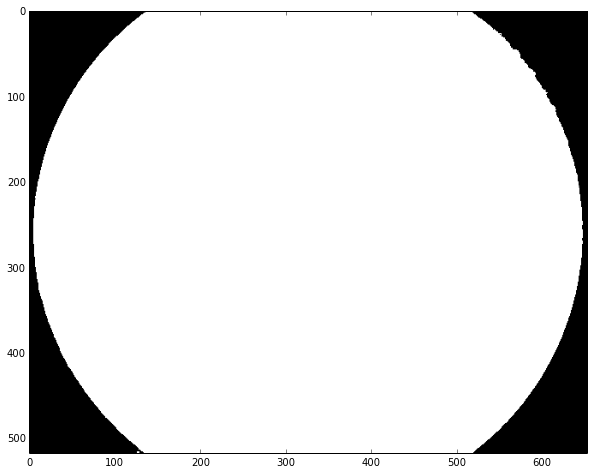

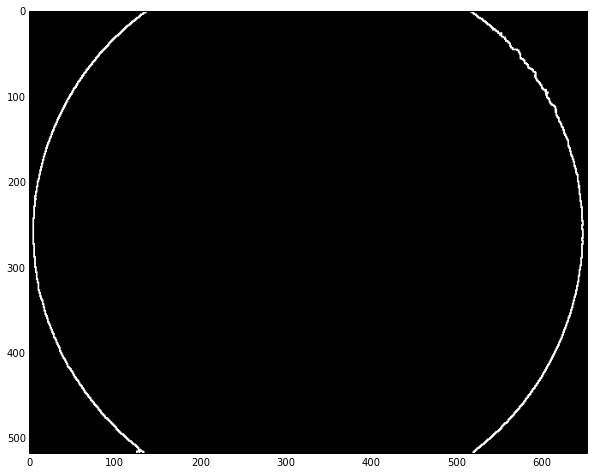

In [244]:
_disk = disk(gb, ztol=20)
_disk_border = disk_border(gb, ztol=20)
show_image(_disk)
show_image(_disk_border)

### Выделение сосудов

Метод из статьи "Сегментация кровеносных сосудов", https://habrahabr.ru/post/259017/ (первый)

* CLAHE
* Average filter, ширина фильтра выбирается равной макс. ширине сосудов
* Вычитание average из изображения
* CLAHE
* Otsu
* Median filter
* Отбросить маленькие белые компоненты

In [136]:
cl1 = skimage.exposure.equalize_adapthist(gb)
cl1 = (cl1 * 256).astype('uint8')

In [137]:
aver = cl1 - mh.mean_filter(cl1, Bc=np.ones((12, 12)))
#aver = cl1 - mh.gaussian_filter(cl1, sigma=0.7)
#aver[aver < 0] = 0
aver = np.abs(aver)
aver = aver.astype('uint8')

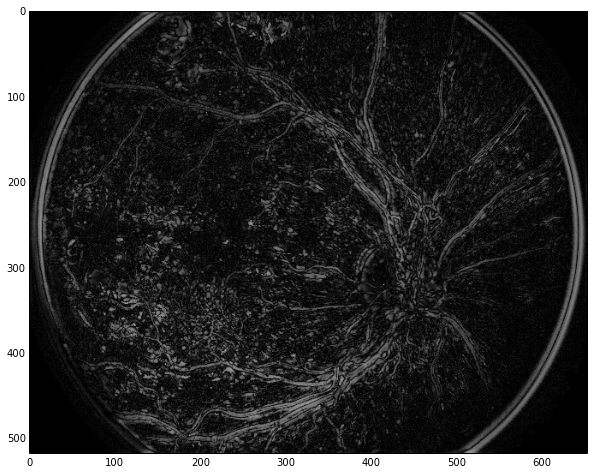

In [139]:
# OpenCV CLAHE
#clahe2 = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(5, 5))
#cl2 = clahe2.apply(aver)
# Hist equalization
#cl2 = (cl2.astype(float) * 256.0 / cl2.max()).astype(np.uint8)
# Skimage CLAHE
cl2 = skimage.exposure.equalize_adapthist(aver)
cl2 *= 256.0 / cl2.max()
#cl2 = (cl2 * 256).astype('uint8')
show_image(cl2)

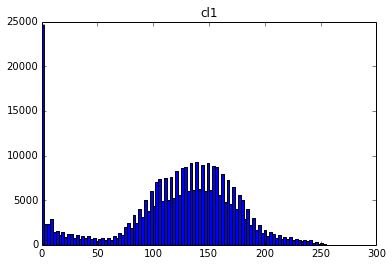

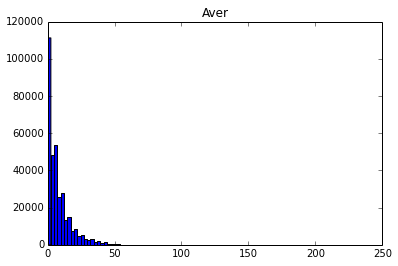

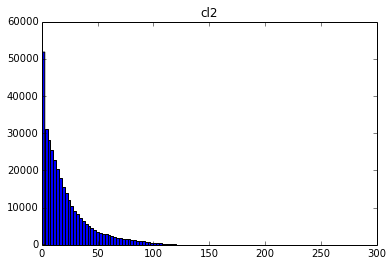

In [214]:
pxl_distr(cl1)
plt.title('cl1')
plt.figure()
pxl_distr(aver)
plt.title('Aver')
plt.figure()
pxl_distr(cl2)
plt.title('cl2')

In [7]:
def exclude_backgr(gb):
    # CLAHE
    cl1 = skimage.exposure.equalize_adapthist(gb)
    cl1 = (cl1 * 256).astype(np.uint8)
    
    # Average filter
    aver = cl1 - mh.mean_filter(cl1, Bc=np.ones((12, 12)))
    #aver[aver < 0] = 0
    aver = np.abs(aver)
    aver = aver.astype(np.uint8)
    
    # CLAHE
    cl2 = skimage.exposure.equalize_adapthist(aver)
    
    return cl2

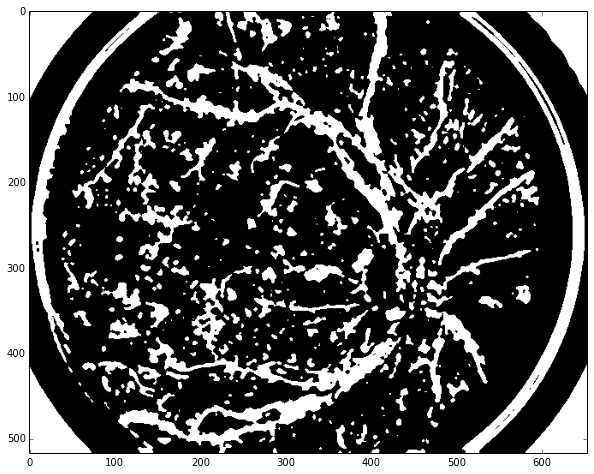

In [663]:
show_image(mh.median_filter(bin_otsu, Bc=np.ones((5, 5))))

Сегментация получается, на мой взгляд, довольно неудачной.

Второй метод из этой статьи: использовать фильтры Габора.

### Фильтры Габора

В статье предлагаются следующие действия:

* CLAHE (адаптивное выравнивание гистограммы)
* Average filter
* CLAHE
* Gaussian filter
* максимум по откликам подобранных фильтров Габора для всех направлений

Картинка получается довольно зашумленной, поэтому дальше моя импровизация:
* отсечение по порогу; порог выбирается как квантиль распределения пикселей
* удаление мелких объектов (белых точек)
* CLAHE

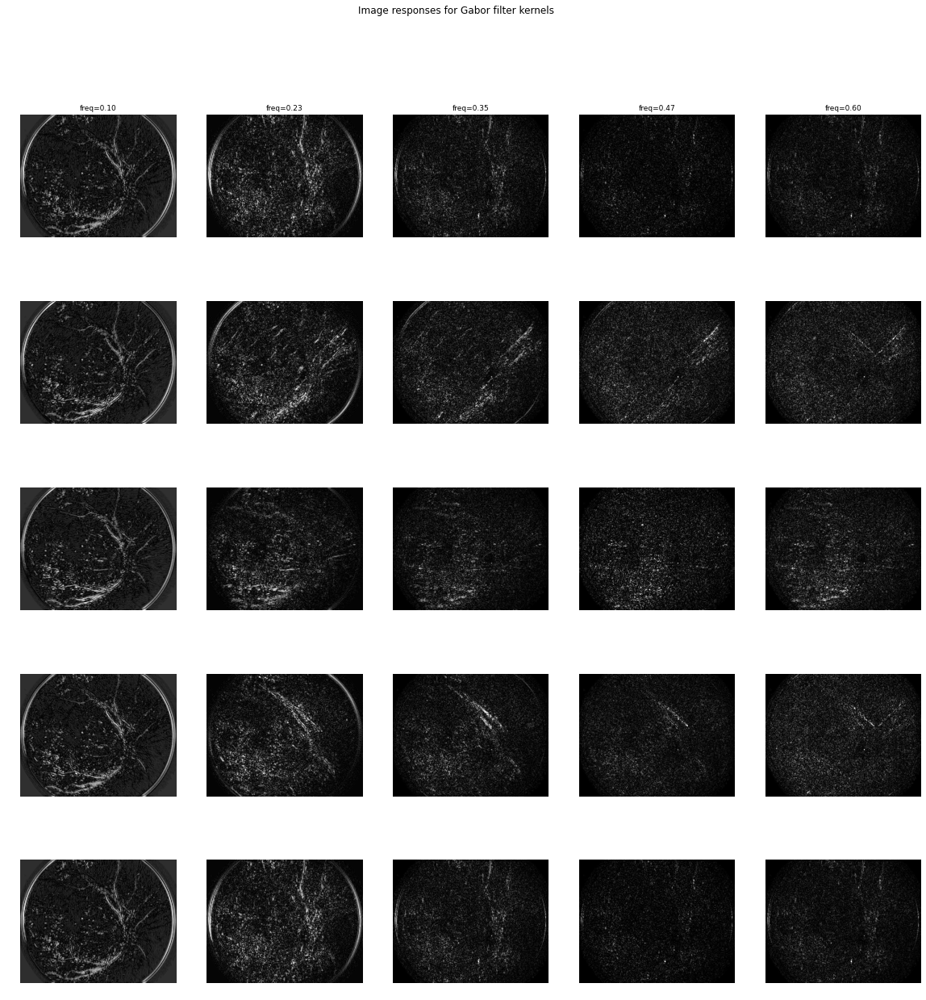

In [415]:
def power(image, kernel):
    # Normalize images for better comparison.
    image = (image - image.mean()) / image.std()
    return np.sqrt(ndi.convolve(image, np.real(kernel), mode='wrap') ** 2 +
                   ndi.convolve(image, np.imag(kernel), mode='wrap') ** 2)


gb2 = exclude_backgr(gb)
# Plot a selection of the filter bank kernels and their responses.
results = []
kernel_params = []
theta_ops = np.linspace(0.0, 4.0, num=5) / 4. * np.pi
freq_ops = np.linspace(0.1, 0.6, num=5)
for theta in theta_ops:
    results.append([])
    for frequency in freq_ops:
        kernel = skimage.filters.gabor_kernel(frequency, theta=theta, bandwidth=0.5, 
                                              sigma_x=2, sigma_y=2, n_stds=10)
        # Save power image for each image
        results[-1].append(power(gb2, kernel))

fig, axes = plt.subplots(nrows=theta_ops.size, ncols=freq_ops.size, 
                         figsize=(20, 20))
plt.gray()

fig.suptitle('Image responses for Gabor filter kernels', fontsize=12)

axes[0][0].axis('off')

# Plot original images
for j in range(freq_ops.size):
    ax = axes[0][j]
    ax.set_title('freq=%.2f' % freq_ops[j], fontsize=9)
    ax.axis('off')

for i in range(theta_ops.size):
    # Plot Gabor kernel
    ax_row = axes[i]
    ax = ax_row[0]
    ax.axis('off')
    #ax.imshow(np.real(results[i][0][0]), interpolation='nearest')
    ax.set_ylabel('theta=%.2f' % theta_ops[i], fontsize=12)
    ax.set_xticks([])
    ax.set_yticks([])

    # Plot Gabor responses with the contrast normalized for each filter
    #vmin = np.min(powers)
    #vmax = np.max(powers)
    for patch, ax in zip(results[i], ax_row):
        vmin, vmax = patch.min(), patch.max()
        ax.imshow(patch, vmin=vmin, vmax=vmax)
        ax.axis('off')

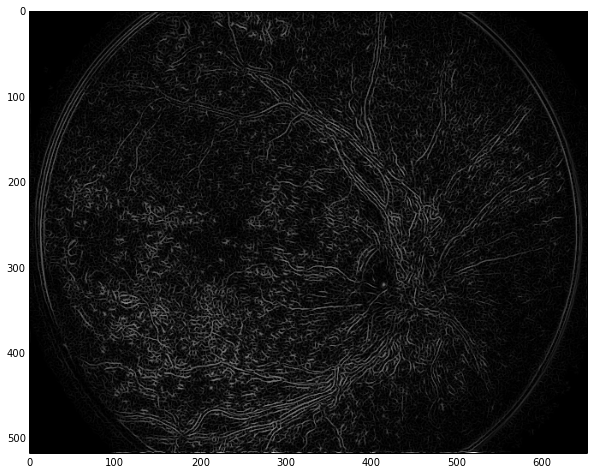

In [216]:
resp = []
gb2 = exclude_backgr(gb)
gb3 = mh.gaussian_filter(gb2, sigma=1.0)

for theta in np.linspace(0.0, 17.0 / 18.0 * np.pi, num=10):
    kernel = skimage.filters.gabor_kernel(frequency=0.4, theta=theta, 
                                          sigma_x=1.0 * 1.5, sigma_y=(1.0 / 1.75) * 1.5,
                                          n_stds=15)
    #resp.append(power(img, kernel))    # equivalent to Gaussian (cos^2 + sin^2 = 1)
    resp.append(ndi.convolve(gb3, np.real(kernel), mode='wrap'))

response = np.max(resp, axis=0)
response[response < 0] = 0
#show_image(response)

# freq=0.3, bandwidth=1.0, n_stds=15
# freq=0.05, sigma_x=2.0, sigma_y=6.0, n_stds=15
# 0.6, 2.0, 3.5, 15
# 0.25, 1.0*2.0, (1.0 / 1.75) * 2.0, 15
# 0.4, 1.0*1.5, (1.0 / 1.75) * 1.5, 15  - ok! except small line segments 
#                                        (but there are some lines there in the image)

response *= 1.0 / response.max()
resp2 = skimage.exposure.equalize_adapthist(response)
show_image(resp2)
resp2 = (resp2 * 256).astype('uint8')

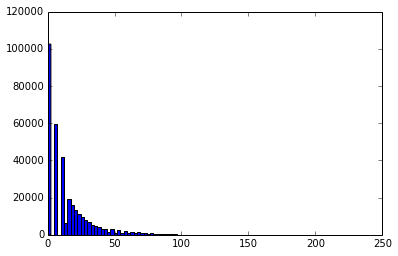

In [217]:
pxl_distr(resp2)

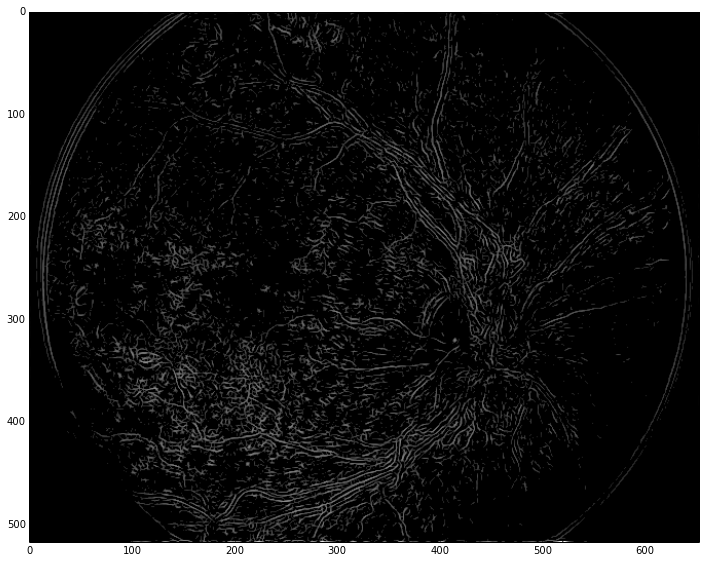

In [218]:
# Removing noise
noise_level = np.percentile(resp2[resp2 != 0].ravel(), 80)
resp3 = np.where(resp2 > noise_level, resp2, 0)
show_image(resp3, fig_size=(12, 12))

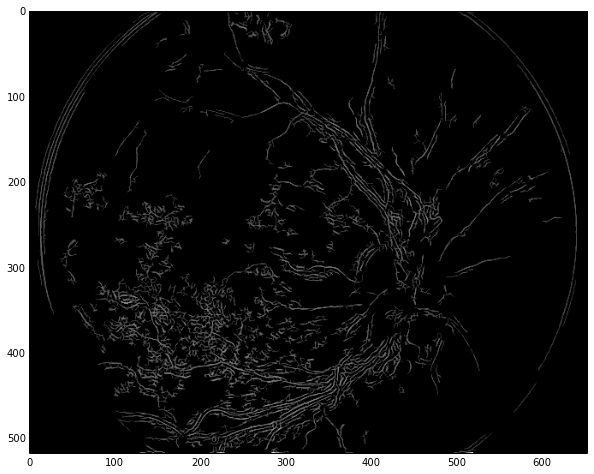

In [225]:
mask_large = skimage.morphology.remove_small_objects(resp3 != 0, min_size=30, connectivity=2)
#pxl_distr(mask_large)
resp4 = np.where(mask_large, resp3, 0)
show_image(resp4)

In [12]:
def vessels_detection_1(gb):
    # Excluding background
    gb2 = exclude_backgr(gb)
    # There is a lot of small noise and details; denoising
    gb3 = mh.gaussian_filter(gb2, sigma=1.0)

    # Computing response of Gabor filter (real part) at different angles
    resp = []
    for theta in np.linspace(0.0, 17.0 / 18.0 * np.pi, num=10):
        kernel = skimage.filters.gabor_kernel(frequency=0.4, theta=theta, 
                                              sigma_x=1.0 * 1.5, sigma_y=(1.0 / 1.75) * 1.5,
                                              n_stds=15)
        #resp.append(power(img, kernel))    # equivalent to Gaussian (cos^2 + sin^2 = 1)
        resp.append(ndi.convolve(gb3, np.real(kernel), mode='wrap'))

    response = np.max(resp, axis=0)
    response[response < 0] = 0
    #show_image(response)

    # freq=0.3, bandwidth=1.0, n_stds=15
    # freq=0.05, sigma_x=2.0, sigma_y=6.0, n_stds=15
    # 0.6, 2.0, 3.5, 15
    # 0.25, 1.0*2.0, (1.0 / 1.75) * 2.0, 15
    # 0.4, 1.0*1.5, (1.0 / 1.75) * 1.5, 15  - ok! except small line segments 
    #                                        (but there are some lines there in the image)
    
    # Histogram equalization
    response *= 1.0 / response.max()
    resp2 = skimage.exposure.equalize_adapthist(response)
    #show_image(resp2)
    resp2 = (resp2 * 256).astype('uint8')
    
    # Removing noise
    noise_level = np.percentile(resp2[resp2 != 0], 80)
    resp3 = np.where(resp2 > noise_level, resp2, 0)
    #show_image(resp3, fig_size=(12, 12))
    
    # Removing small objects
    mask_large = skimage.morphology.remove_small_objects(resp3 != 0, min_size=30, connectivity=2)
    #pxl_distr(mask_large)
    resp4 = np.where(mask_large, resp3, 0)
    
    return resp4

In [233]:
%time vess = vessels_detection_1(gb)

CPU times: user 3.56 s, sys: 0 ns, total: 3.56 s
Wall time: 3.57 s


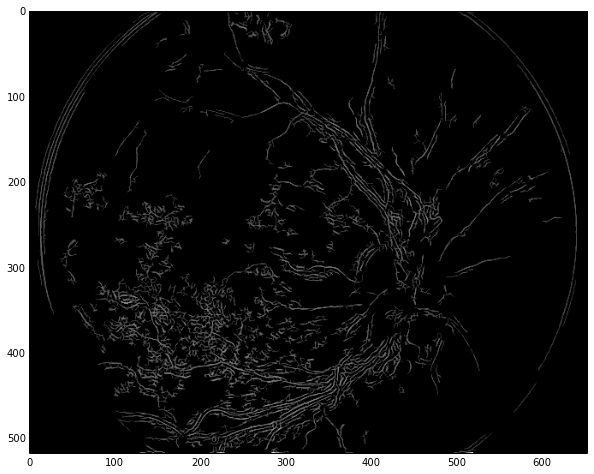

In [234]:
show_image(vess)

Сосуды выделяются неплохо, хотя остаются мелкие линии (фильтр реагирует либо на мелкие сосуды, либо на шумовые пиксели).

#### Сравнение со старым алгоритмом выделения сосудов на основе выделения границ:

In [13]:
def vessels_detection_2(gb):
    laplacian = cv2.Laplacian(gb.astype(np.uint8), cv2.CV_8U, dst=10, ksize=5, scale=1)
    #lapl_median = mh.median_filter(laplacian, Bc=np.ones((10, 10)))
    lapl_close = mh.close(laplacian, Bc=np.ones((3, 3)))
    #venues = mh.dilate(lapl_close < laplacian, Bc=np.ones((4, 4)))
    venues = lapl_close < laplacian

    #venues = 1 - mh.close_holes(1 - venues, Bc=np.ones((10, 10)))
    # Distance transform
    #_, venues_distt = skimage.morphology.medial_axis(venues, mask, return_distance=True)
    #venues = np.where(venues_distt >= 1, 1, 0)
    #venues = mh.dilate(venues, Bc=np.ones((3, 3))) - 1

    # Bfs segmentation of response
    venues_cl = bfs_clustered(venues.astype(int), radius=3, tol=0.5)
    venues_cl = erase_clusters(venues_cl, small_tol=8, small_replace=0)
    venues = venues_cl != 0

    venues = mh.dilate(venues, Bc=np.ones((4, 4)))
    
    result = np.where(venues, gb, 0)
    return result

In [240]:
%time ans = vessels_detection_2(gb)

CPU times: user 51.5 s, sys: 196 ms, total: 51.7 s
Wall time: 54.8 s


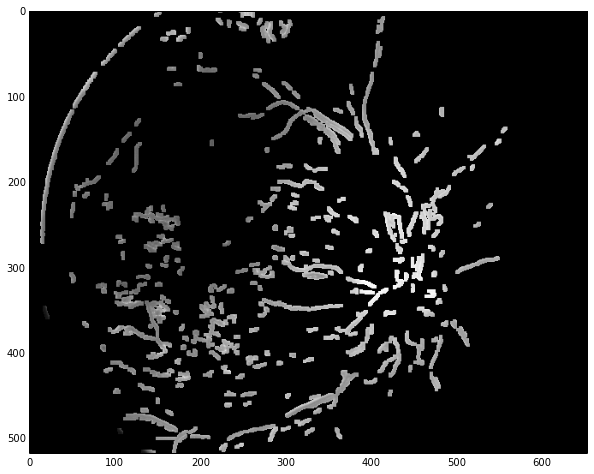

In [241]:
show_image(ans)

Здесь найдено существенно меньше сосудов.

Метод из работы Черноморца, Крылова "Automated processing of retinal images"

In [8]:
import pixels_features as pf

def correct_luminosity(img, backgr_thr=0.7):
    eps = 1e-8
    
    new_img = np.empty_like(img)
    for k in xrange(3):
        ch = img[:, :, k]
        mean = pf.pxls_mean_intensity(ch, stride_width=1, neighbd_rad=6).reshape(ch.shape)
        std = pf.pxls_std_intensity(ch, stride_width=1, neighbd_rad=6).reshape(ch.shape)
        D = np.abs((ch - mean) / (std + eps))
        backgr_mask = D < backgr_thr
        mean_intens = pf.pxls_mean_intensity_of_masked(ch, mask, stride_width=5, neighbd_rad=3).reshape(ch.shape)
        ans = 0.5 * ch / (mean_intens + eps)
        new_img[:, :, k] = ans
    return new_img

In [8]:
import imhandle as imh

lum = correct_luminosity(img, backgr_thr=0.7)
imh.plot_subfigures([img, lum], fig_size=(20, 10))

NameError: name 'correct_luminosity' is not defined

(-0.5, 456.5, 220.5, -0.5)

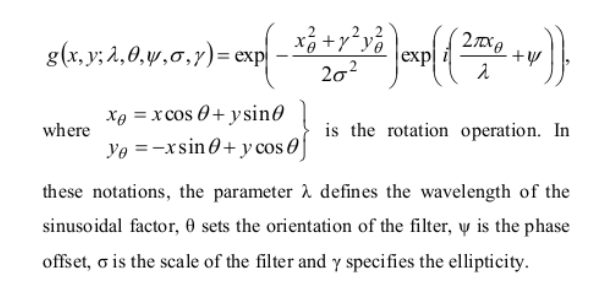

In [53]:
imh.show_image(imh.load_image('/home/artem/Изображения/Снимок экрана от 2016-04-19 09:22:02.png'))
plt.axis('off')

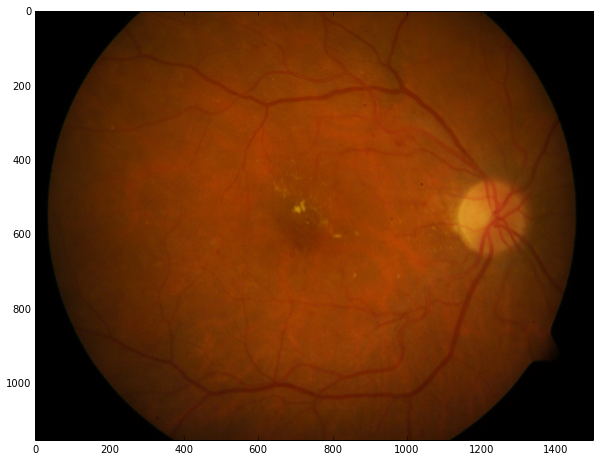

In [14]:
import imhandle as imh

img = imh.load_image('../data/DIARETDB1/diaretdb1_v_1_1/resources/images/ddb1_fundusimages/image001.png')
imh.show_image(img)

In [15]:
import imhandle as imh

@jit
def gabor_kernel(radius, _lambda, theta, phi, sigma, gamma):
    kernel = np.empty((2 * radius + 1, 2 * radius + 1), dtype=np.complex128)
    # kernel[radius, radius] is the center point
    # x is headed rightwards from center, y -- upwards
    for x in xrange(-radius, radius + 1):
        for y in xrange(-radius, radius + 1):
            i = radius - y    # = 2 * radius - (y + radius)
            j = x + radius
            x_theta = x * np.cos(theta) + y * np.sin(theta)
            y_theta = -x * np.sin(theta) + y * np.cos(theta)
            resp = np.exp(-(x_theta ** 2 + gamma ** 2 * y_theta ** 2) / (2.0 * sigma ** 2) + \
                          1.0j * (2 * np.pi * x_theta / _lambda + phi))
            kernel[i, j] = resp
    return kernel


def vessels_detection_1(gb, sigma_0=10.0):
    gb2 = mh.median_filter(gb)
    gb2 = skimage.exposure.equalize_adapthist(gb2)
    # Excluding background
    #gb2 = exclude_backgr(gb)
    #gb2 = mh.median_filter(gb2)
    # There is a lot of small noise and details; denoising
    #gb3 = mh.gaussian_filter(gb2, sigma=1.0)

    # Computing response of Gabor filter (real part) at different angles
    resp = []
    for theta in np.linspace(0.0, 150.0 / 180.0 * np.pi, num=6):
        for factor in [0.25, 0.5, 0.75, 1.0]:
            sigma = sigma_0 * factor
            #kernel = skimage.filters.gabor_kernel(frequency=3 * sigma, theta=theta, 
            #                                      sigma_x=sigma, sigma_y=sigma,
            #                                      n_stds=5, offset=np.pi)
            kernel = gabor_kernel(radius=20, _lambda=3 * sigma, theta=theta, phi=np.pi, sigma=sigma, gamma=1.0)
            print 'theta: {}, factor: {}'.format(theta, factor)
            #print kernel
            #resp.append(power(img, kernel))    # equivalent to Gaussian (cos^2 + sin^2 = 1)
            resp.append(ndi.convolve(gb2, kernel, mode='wrap'))

    resp = np.array(resp)
    resp_abs_argmax = np.argmax(np.abs(resp), axis=0)
    print 'resp shape:', resp.shape
    print resp_abs_argmax
    #response = resp[np.argmax(np.abs(resp), axis=0)]
    response = np.empty_like(gb2)
    response_real = np.empty_like(gb2)
    response_imag = np.empty_like(gb2)
    for k in xrange(resp.shape[0]):
        response = np.where(resp_abs_argmax == k, np.abs(resp[k]), response)
        response_real = np.where(resp_abs_argmax == k, np.real(resp[k]), response)
        response_imag = np.where(resp_abs_argmax == k, np.imag(resp[k]), response)
    #show_image(resp[0])
    show_image(response)
    show_image(response_real)
    plt.show()
    #show_image(response_imag)

    # freq=0.3, bandwidth=1.0, n_stds=15
    # freq=0.05, sigma_x=2.0, sigma_y=6.0, n_stds=15
    # 0.6, 2.0, 3.5, 15
    # 0.25, 1.0*2.0, (1.0 / 1.75) * 2.0, 15
    # 0.4, 1.0*1.5, (1.0 / 1.75) * 1.5, 15  - ok! except small line segments 
    #                                        (but there are some lines there in the image)
    
    # Histogram equalization
    response = imh.normalize_image(response)
    #resp2 = skimage.exposure.equalize_adapthist(response)
    #show_image(resp2)
    #resp2 = (resp2 * 256).astype('uint8')
    
    # Removing noise
    #noise_level = np.percentile(resp2[resp2 != 0], 80)
    #resp3 = np.where(resp2 > noise_level, resp2, 0)
    #show_image(resp3, fig_size=(12, 12))
    
    # Removing small objects
    #response = skimage.morphology.remove_small_objects(response, min_size=30, connectivity=2)
    
    #response = response > 0.3
    #pxl_distr(mask_large)
    #resp4 = np.where(mask_large, resp3, 0)
    
    return response

/usr/local/lib/python2.7/dist-packages/skimage/exposure/_adapthist.py:262: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 256 but corresponding boolean dimension is 253
  hist[under] += 1
/usr/local/lib/python2.7/dist-packages/skimage/exposure/_adapthist.py:263: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 256 but corresponding boolean dimension is 253
  n_excess -= hist[under].size
/usr/local/lib/python2.7/dist-packages/skimage/exposure/_adapthist.py:262: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 256 but corresponding boolean dimension is 252
  hist[under] += 1
/usr/local/lib/python2.7/dist-packages/skimage/exposure/_adapthist.py:263: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 256 but corresponding boolean dimension is 252
  n_excess -= hist[under].size
/usr/loc

sigma_0= 0.5
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75
theta: 0.523598775598, factor: 1.0
theta: 1.0471975512, factor: 0.25
theta: 1.0471975512, factor: 0.5
theta: 1.0471975512, factor: 0.75
theta: 1.0471975512, factor: 1.0
theta: 1.57079632679, factor: 0.25
theta: 1.57079632679, factor: 0.5
theta: 1.57079632679, factor: 0.75
theta: 1.57079632679, factor: 1.0
theta: 2.09439510239, factor: 0.25
theta: 2.09439510239, factor: 0.5
theta: 2.09439510239, factor: 0.75
theta: 2.09439510239, factor: 1.0
theta: 2.61799387799, factor: 0.25
theta: 2.61799387799, factor: 0.5
theta: 2.61799387799, factor: 0.75
theta: 2.61799387799, factor: 1.0
resp shape: (24, 1152, 1500)
[[ 3  3  3 ..., 14 14  2]
 [ 2  2  2 ...,  2  2  2]
 [ 2  2  2 ...,  2  2  2]
 ..., 
 [ 3  2  3 ..., 14 14 15]
 [ 3 15 14 ..., 14 14 15]
 [ 3 15 15 ..., 14 14 15]]


/usr/local/lib/python2.7/dist-packages/skimage/exposure/_adapthist.py:263: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 256 but corresponding boolean dimension is 23
  n_excess -= hist[under].size
/usr/local/lib/python2.7/dist-packages/skimage/exposure/_adapthist.py:262: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 256 but corresponding boolean dimension is 11
  hist[under] += 1
/usr/local/lib/python2.7/dist-packages/skimage/exposure/_adapthist.py:263: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 256 but corresponding boolean dimension is 11
  n_excess -= hist[under].size
/usr/local/lib/python2.7/dist-packages/skimage/exposure/_adapthist.py:262: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 256 but corresponding boolean dimension is 245
  hist[under] += 1
/usr/local/

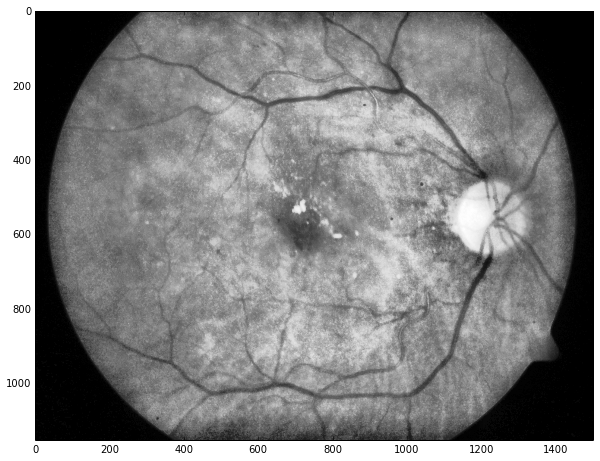

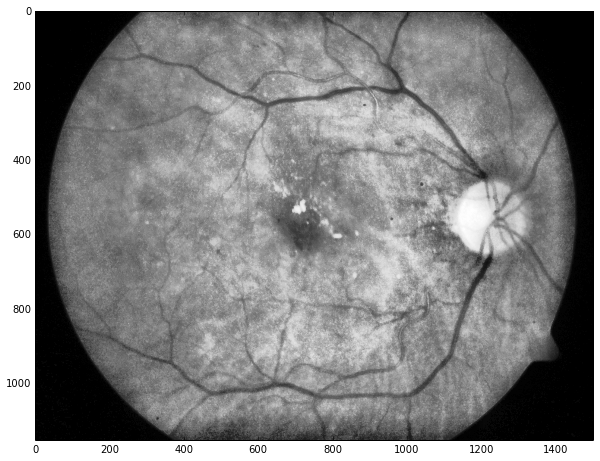

sigma_0= 2.0
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75
theta: 0.523598775598, factor: 1.0
theta: 1.0471975512, factor: 0.25
theta: 1.0471975512, factor: 0.5
theta: 1.0471975512, factor: 0.75
theta: 1.0471975512, factor: 1.0
theta: 1.57079632679, factor: 0.25
theta: 1.57079632679, factor: 0.5
theta: 1.57079632679, factor: 0.75
theta: 1.57079632679, factor: 1.0
theta: 2.09439510239, factor: 0.25
theta: 2.09439510239, factor: 0.5
theta: 2.09439510239, factor: 0.75
theta: 2.09439510239, factor: 1.0
theta: 2.61799387799, factor: 0.25
theta: 2.61799387799, factor: 0.5
theta: 2.61799387799, factor: 0.75
theta: 2.61799387799, factor: 1.0
resp shape: (24, 1152, 1500)
[[23  3  7 ..., 19 19 19]
 [23  3  7 ..., 19 19 23]
 [ 3  3  3 ..., 19 23 23]
 ..., 
 [ 3  3  7 ...,  3  3 11]
 [ 3  7 11 ..., 15 15 15]
 [15  7 11 ..., 15 15 19]]


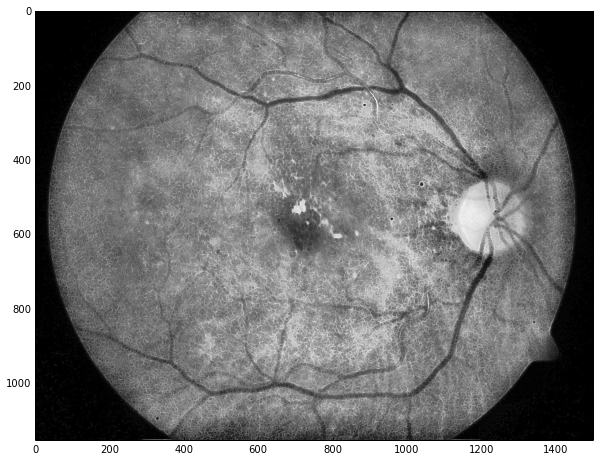

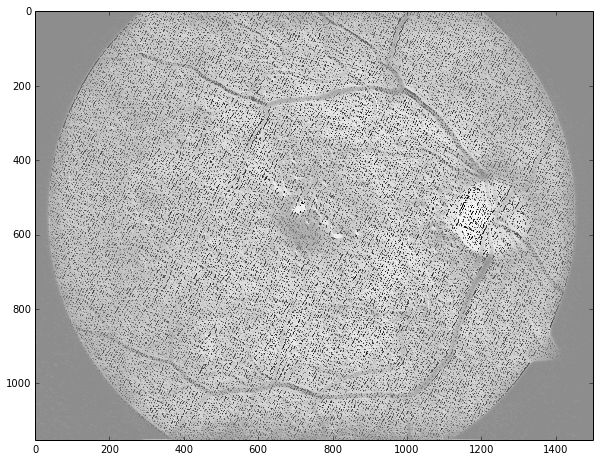

sigma_0= 3.0
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75
theta: 0.523598775598, factor: 1.0
theta: 1.0471975512, factor: 0.25
theta: 1.0471975512, factor: 0.5
theta: 1.0471975512, factor: 0.75
theta: 1.0471975512, factor: 1.0
theta: 1.57079632679, factor: 0.25
theta: 1.57079632679, factor: 0.5
theta: 1.57079632679, factor: 0.75
theta: 1.57079632679, factor: 1.0
theta: 2.09439510239, factor: 0.25
theta: 2.09439510239, factor: 0.5
theta: 2.09439510239, factor: 0.75
theta: 2.09439510239, factor: 1.0
theta: 2.61799387799, factor: 0.25
theta: 2.61799387799, factor: 0.5
theta: 2.61799387799, factor: 0.75
theta: 2.61799387799, factor: 1.0
resp shape: (24, 1152, 1500)
[[ 3  3  7 ..., 19 19 23]
 [ 3  3  7 ..., 19 23 23]
 [ 3  3  3 ..., 23 23 23]
 ..., 
 [ 3  3  7 ...,  3 15 23]
 [ 3  3  7 ..., 15 15 23]
 [ 3  3  7 ..., 19 19 23]]


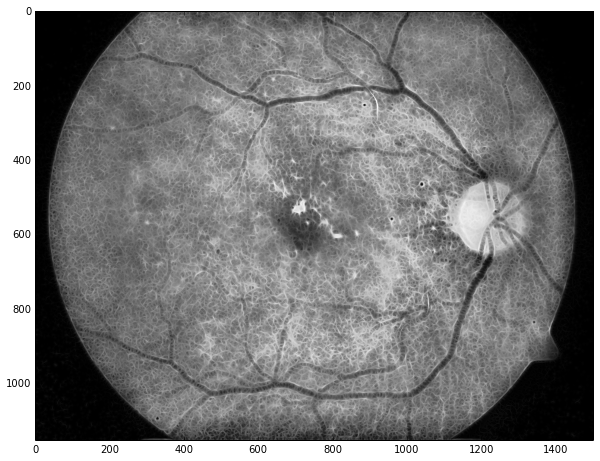

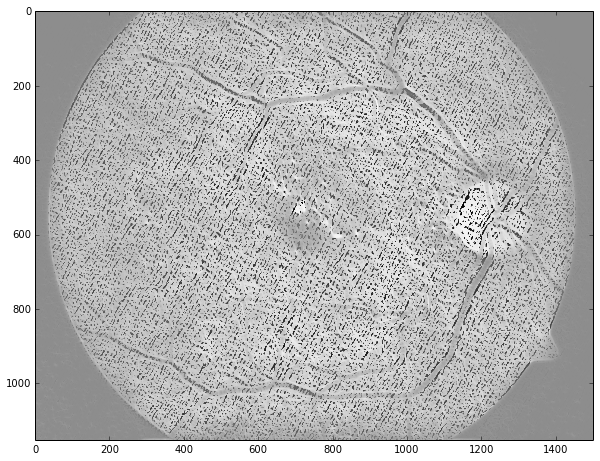

sigma_0= 4.0
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75
theta: 0.523598775598, factor: 1.0
theta: 1.0471975512, factor: 0.25
theta: 1.0471975512, factor: 0.5
theta: 1.0471975512, factor: 0.75
theta: 1.0471975512, factor: 1.0
theta: 1.57079632679, factor: 0.25
theta: 1.57079632679, factor: 0.5
theta: 1.57079632679, factor: 0.75
theta: 1.57079632679, factor: 1.0

In [ ]:
for sigma_0 in [0.5, 2.0, 3.0, 4.0]:
    print 'sigma_0=', sigma_0
    intensity = img.mean(axis=2) / 256.0
    intensity = skimage.exposure.equalize_adapthist(intensity)
    #imh.show_image(intensity)
    vessels = vessels_detection_1(intensity, sigma_0)
    #imh.show_image(vessels)

sigma_0= 0.5
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75
theta: 0.523598775598, factor: 1.0
theta: 1.0471975512, factor: 0.25
theta: 1.0471975512, factor: 0.5
theta: 1.0471975512, factor: 0.75
theta: 1.0471975512, factor: 1.0
theta: 1.57079632679, factor: 0.25
theta: 1.57079632679, factor: 0.5
theta: 1.57079632679, factor: 0.75
theta: 1.57079632679, factor: 1.0
theta: 2.09439510239, factor: 0.25
theta: 2.09439510239, factor: 0.5
theta: 2.09439510239, factor: 0.75
theta: 2.09439510239, factor: 1.0
theta: 2.61799387799, factor: 0.25
theta: 2.61799387799, factor: 0.5
theta: 2.61799387799, factor: 0.75
theta: 2.61799387799, factor: 1.0
resp shape: (24, 1152, 1500)
[[ 3  3  3 ...,  3  7 11]
 [ 3  3  3 ...,  3 23 11]
 [15 15 15 ...,  3 15 15]
 ..., 
 [ 3  7  3 ...,  3 15 15]
 [ 3 15  3 ...,  3 15 15]
 [ 3 15 15 ...,  3 15 15]]


/usr/local/lib/python2.7/dist-packages/skimage/exposure/_adapthist.py:262: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 256 but corresponding boolean dimension is 42
  hist[under] += 1
/usr/local/lib/python2.7/dist-packages/skimage/exposure/_adapthist.py:263: VisibleDeprecationWarning: boolean index did not match indexed array along dimension 0; dimension is 256 but corresponding boolean dimension is 42
  n_excess -= hist[under].size


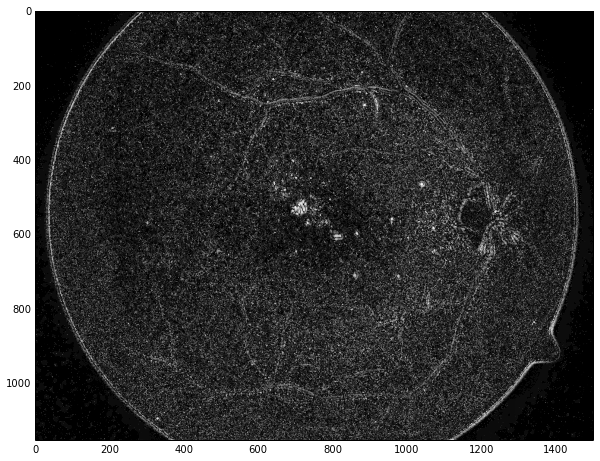

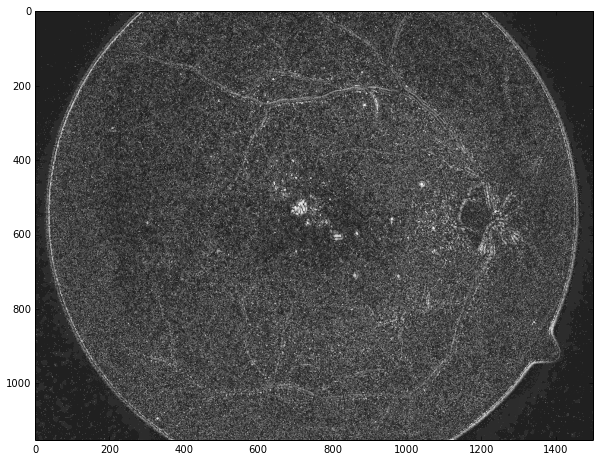

sigma_0= 2.0
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75
theta: 0.523598775598, factor: 1.0
theta: 1.0471975512, factor: 0.25
theta: 1.0471975512, factor: 0.5
theta: 1.0471975512, factor: 0.75
theta: 1.0471975512, factor: 1.0
theta: 1.57079632679, factor: 0.25
theta: 1.57079632679, factor: 0.5
theta: 1.57079632679, factor: 0.75
theta: 1.57079632679, factor: 1.0
theta: 2.09439510239, factor: 0.25
theta: 2.09439510239, factor: 0.5
theta: 2.09439510239, factor: 0.75
theta: 2.09439510239, factor: 1.0
theta: 2.61799387799, factor: 0.25
theta: 2.61799387799, factor: 0.5
theta: 2.61799387799, factor: 0.75
theta: 2.61799387799, factor: 1.0
resp shape: (24, 1152, 1500)
[[23  3  7 ...,  3  7  7]
 [11 15 15 ...,  3  7 11]
 [15 11 15 ...,  3 15 15]
 ..., 
 [ 3  3  7 ...,  3  3 23]
 [ 3  7  7 ...,  3  7 23]
 [ 3  7  7 ...,  3  7  7]]


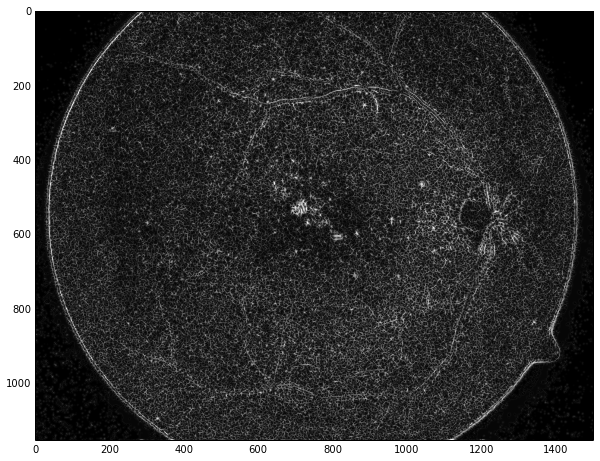

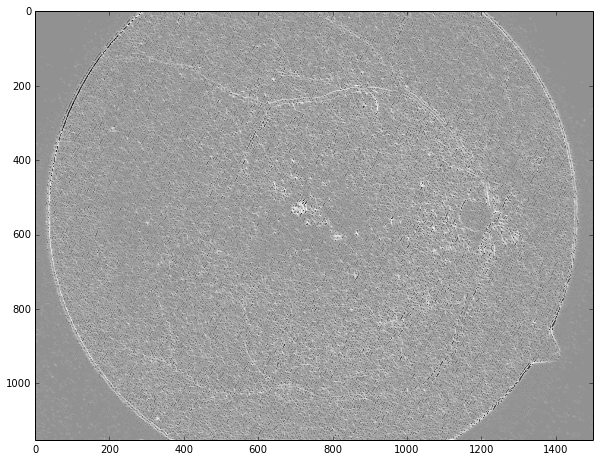

sigma_0= 5.0
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75
theta: 0.523598775598, factor: 1.0
theta: 1.0471975512, factor: 0.25
theta: 1.0471975512, factor: 0.5
theta: 1.0471975512, factor: 0.75
theta: 1.0471975512, factor: 1.0
theta: 1.57079632679, factor: 0.25
theta: 1.57079632679, factor: 0.5
theta: 1.57079632679, factor: 0.75
theta: 1.57079632679, factor: 1.0
theta: 2.09439510239, factor: 0.25
theta: 2.09439510239, factor: 0.5
theta: 2.09439510239, factor: 0.75
theta: 2.09439510239, factor: 1.0
theta: 2.61799387799, factor: 0.25
theta: 2.61799387799, factor: 0.5
theta: 2.61799387799, factor: 0.75
theta: 2.61799387799, factor: 1.0
resp shape: (24, 1152, 1500)
[[ 3  3  7 ..., 23 23  3]
 [ 3  3  7 ..., 23 23  3]
 [ 3  3  3 ..., 23 23  3]
 ..., 
 [ 3  3  3 ..., 23 23  3]
 [ 3  3  3 ..., 23 23  3]
 [ 3  3  7 ..., 23 23  3]]


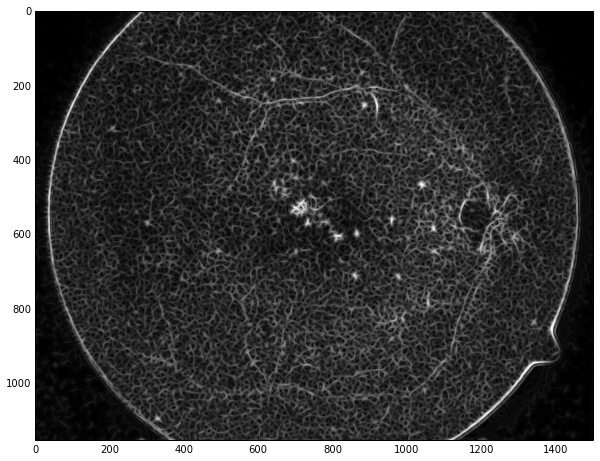

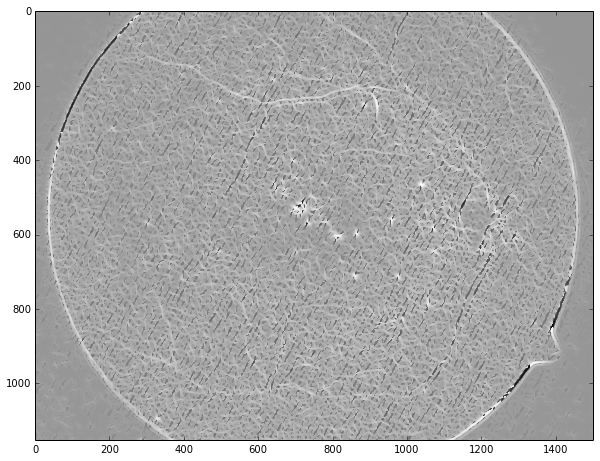

sigma_0= 7.0
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75
theta: 0.523598775598, factor: 1.0
theta: 1.0471975512, factor: 0.25
theta: 1.0471975512, factor: 0.5
theta: 1.0471975512, factor: 0.75
theta: 1.0471975512, factor: 1.0
theta: 1.57079632679, factor: 0.25
theta: 1.57079632679, factor: 0.5
theta: 1.57079632679, factor: 0.75
theta: 1.57079632679, factor: 1.0
theta: 2.09439510239, factor: 0.25
theta: 2.09439510239, factor: 0.5
theta: 2.09439510239, factor: 0.75
theta: 2.09439510239, factor: 1.0
theta: 2.61799387799, factor: 0.25
theta: 2.61799387799, factor: 0.5
theta: 2.61799387799, factor: 0.75
theta: 2.61799387799, factor: 1.0
resp shape: (24, 1152, 1500)
[[ 3  2  6 ..., 23 23  3]
 [ 3  2  6 ..., 23 23  3]
 [ 3  3  2 ..., 23 23  3]
 ..., 
 [ 2  2  2 ..., 23 23 23]
 [ 2  2  2 ..., 23 23 23]
 [ 3  2  6 ..., 23 23  3]]


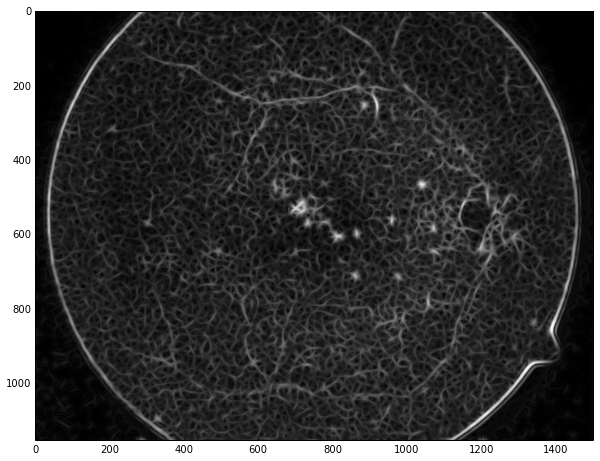

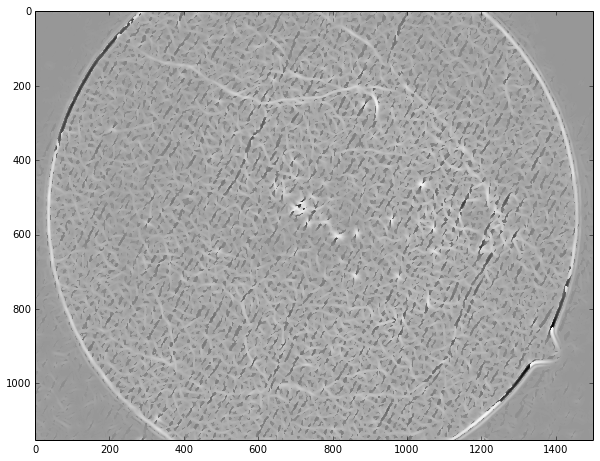

sigma_0= 10.0
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75
theta: 0.523598775598, factor: 1.0
theta: 1.0471975512, factor: 0.25
theta: 1.0471975512, factor: 0.5
theta: 1.0471975512, factor: 0.75
theta: 1.0471975512, factor: 1.0
theta: 1.57079632679, factor: 0.25
theta: 1.57079632679, factor: 0.5
theta: 1.57079632679, factor: 0.75
theta: 1.57079632679, factor: 1.0
theta: 2.09439510239, factor: 0.25
theta: 2.09439510239, factor: 0.5
theta: 2.09439510239, factor: 0.75
theta: 2.09439510239, factor: 1.0
theta: 2.61799387799, factor: 0.25
theta: 2.61799387799, factor: 0.5
theta: 2.61799387799, factor: 0.75
theta: 2.61799387799, factor: 1.0
resp shape: (24, 1152, 1500)
[[23 23 23 ..., 23 23 23]
 [23 23 23 ..., 23 23 23]
 [11 11 11 ..., 23 11 11]
 ..., 
 [23 23 23 ..., 23 23 23]
 [23 23 23 ..., 23 23 23]
 [23 23 23 ..., 23 23 23]]


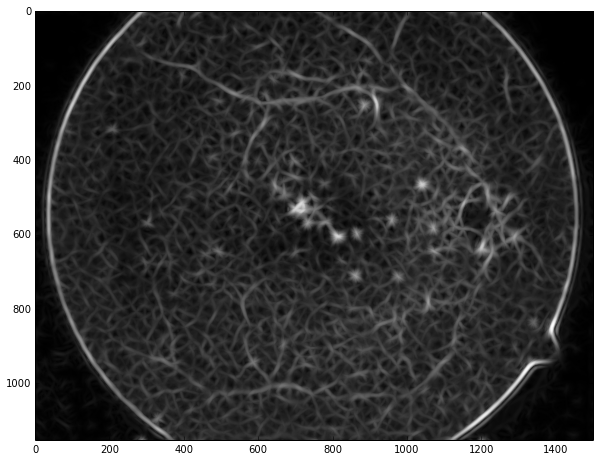

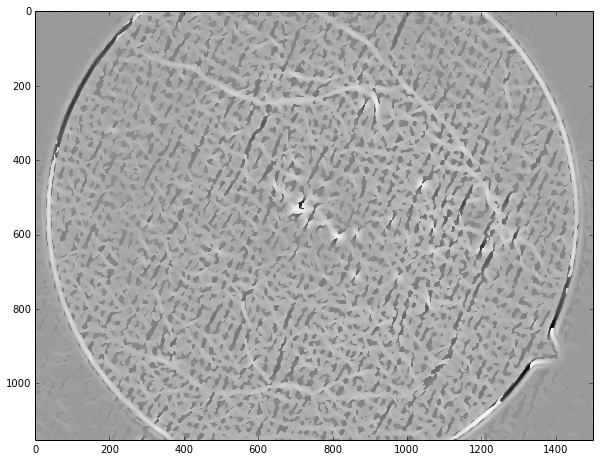

sigma_0= 12.0
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75
theta: 0.523598775598, factor: 1.0
theta: 1.0471975512, factor: 0.25
theta: 1.0471975512, factor: 0.5
theta: 1.0471975512, factor: 0.75
theta: 1.0471975512, factor: 1.0
theta: 1.57079632679, factor: 0.25
theta: 1.57079632679, factor: 0.5
theta: 1.57079632679, factor: 0.75
theta: 1.57079632679, factor: 1.0
theta: 2.09439510239, factor: 0.25
theta: 2.09439510239, factor: 0.5
theta: 2.09439510239, factor: 0.75
theta: 2.09439510239, factor: 1.0
theta: 2.61799387799, factor: 0.25
theta: 2.61799387799, factor: 0.5
theta: 2.61799387799, factor: 0.75
theta: 2.61799387799, factor: 1.0
resp shape: (24, 1152, 1500)
[[23 23 23 ..., 19 23 23]
 [23 23 23 ..., 19 23 23]
 [23 23 23 ..., 23 23 23]
 ..., 
 [23 23 23 ..., 19 23 23]
 [23 23 23 ..., 19 23 23]
 [23 23 23 ..., 19 23 23]]


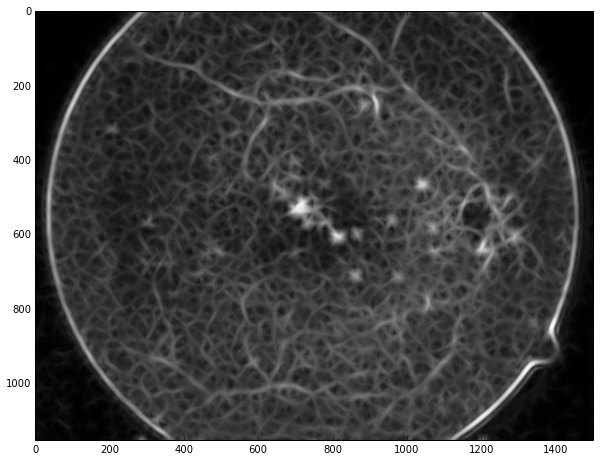

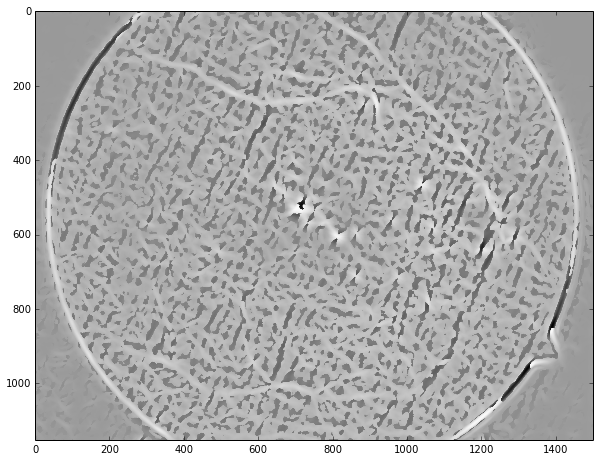

sigma_0= 15.0
theta: 0.0, factor: 0.25
theta: 0.0, factor: 0.5
theta: 0.0, factor: 0.75
theta: 0.0, factor: 1.0
theta: 0.523598775598, factor: 0.25
theta: 0.523598775598, factor: 0.5
theta: 0.523598775598, factor: 0.75


KeyboardInterrupt: 

In [79]:
for sigma_0 in [0.5, 2.0, 4.0]:
    print 'sigma_0=', sigma_0
    intensity = img.mean(axis=2) / 256.0
    intensity = exclude_backgr(intensity)
    #imh.show_image(intensity)
    vessels = vessels_detection_1(intensity, sigma_0)
    #imh.show_image(vessels)

In [ ]:
vessels_1 = skimage.morphology.remove_small_objects(vessels < 0.3, min_size=100)
imh.show_image(vessels_1)

In [139]:
@jit
def amoebas_dilation(img, segm, _lambda=0.1, threshold=5, dist_thr=25, radius=10):
    new_segm = segm.copy()
    for i in xrange(segm.shape[0]):
        for j in xrange(segm.shape[1]):
            if segm[i, j]:
                for k in xrange(i - radius, i + radius + 1):
                    for l in xrange(j - radius, j + radius + 1):
                        if not new_segm[k, l]:
                            dist = np.sqrt((k - i) ** 2 + (l - j) ** 2) + \
                                _lambda * np.sqrt(img[k, l] ** 2 + img[i, j] ** 2)
                            if dist <= dist_thr:
                                new_segm[k, l] = True
    return new_segm

In [ ]:
eroded = vessels_1
for i in xrange(5):
    dilated = amoebas_dilation(vessels, eroded, _lambda=50.0, threshold=5, dist_thr=10, radius=10)
    eroded = mh.erode(dilated)
    imh.show_image(eroded)

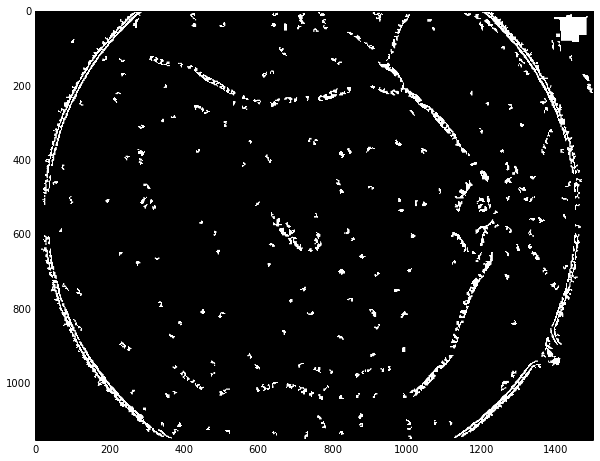

In [138]:
import pixels_features as pf

intensity = img.mean(axis=2) / 256.0
intensity = skimage.exposure.equalize_adapthist(intensity)
minima = mh.mean_filter(pf.local_minima(vessels, 3, 20), Bc=np.ones((3, 3)))
minima = minima != 0
minima = mh.close(minima)
minima = skimage.morphology.remove_small_objects(minima)
imh.show_image(minima)

### Выделение пятен стекловидного тела, белого пятна

Для выделения пятен стекловидного тела и белого пятна применяется сегментация на основе BFS (поиска в ширину): от каждого пикселя разрастается компонента похожего на него цвета. Далее удаляются слишком маленькие и слишком большие компоненты. В результате остаются компоненты среднего размера.

In [37]:
def objects_map(gb):
    bfs = bfs_clustered(gb, radius=7, tol=5)
    bfs2 = erase_clusters(bfs, small_tol=20, large_tol=500, small_replace=0)
    
    return bfs2

In [38]:
%time mask = objects_map(gb)

CPU times: user 6min 6s, sys: 1.28 s, total: 6min 7s
Wall time: 6min 15s


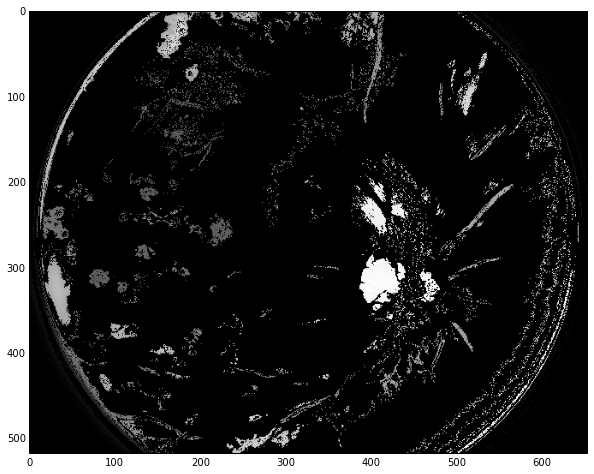

In [39]:
result = np.where(mask, gb, 0.0)
show_image(result)

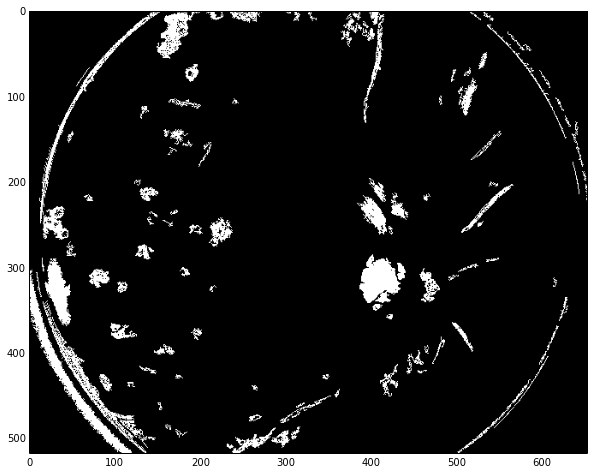

In [23]:
ans2 = skimage.morphology.remove_small_objects(result != 0, min_size=20, connectivity=2)
show_image(ans2)

#### Метод выделения оптического диска, предложенный в статье Huiqi Li «Automated Feature Extraction in Color Retinal Images by a Model Based Approach»

Схема метода:
1. Изображение переводится в цветовое пространство Luv
2. Разделяется на 64 подызображения (с целью разделить на более однородные области)
3. Подсчитывается difference image $D(i, j)$:
$$ D(i, j) = \sqrt{(L(i, j) - L_r)^2 + (u(i, j) - u_r)^2}, $$
где $L_r$, $u_r$ -- средний цвет в подызображении по каналам L, u соответственно.
4. Применяется адаптивный фильтр Винера для фильтрации шумов.
5. Применяется модификация алгоритма region growing: начиная из стартовых точек (seeds), алгоритм расширяет компоненты, пока не наткнется на край, большой градиент или сильное отклонение по цвету от цвета стартовой точки. Стартовые точки выбираются как минимумы изображения после порогового отсечения по цвету. Поиск краев производится методом Canny поиска контуров на изображении.

http://www-prima.inrialpes.fr/perso/Tran/ICCV03-Proceedings/ICCV/iccv03/0394_li.pdf

Из статьи не очень понятно, как предлагается считать difference image, поэтому предлагается другой метод: для выравнивания контраста по всей площади картинки применять локальную эквализацию гистограммы (CLAHE). Так как контраст становится примерно одинаковым по всей картинке, то, скорее всего, можно не разбивать изображение на части.

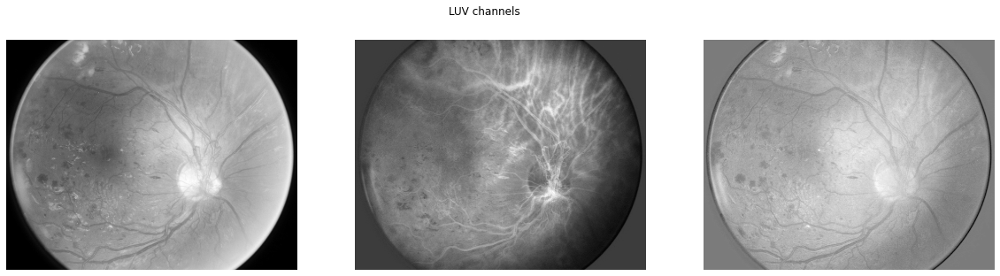

In [138]:
img_luv = skimage.color.rgb2luv(img)
img_luv = normalize_image(img_luv)
plot_subfigures([img_luv[:, :, i] for i in range(3)], 'LUV channels', fig_size=(20, 5))

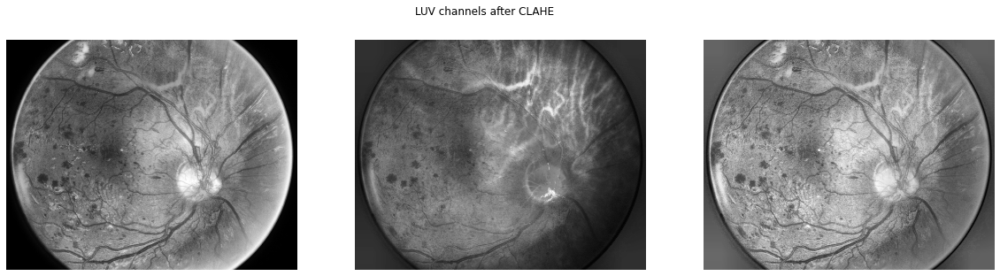

In [139]:
img_luv2 = skimage.exposure.equalize_adapthist(img_luv)
normalize_image(img_luv2)
plot_subfigures([img_luv2[:, :, i] for i in range(3)], 
                'LUV channels after CLAHE', fig_size=(20, 5))

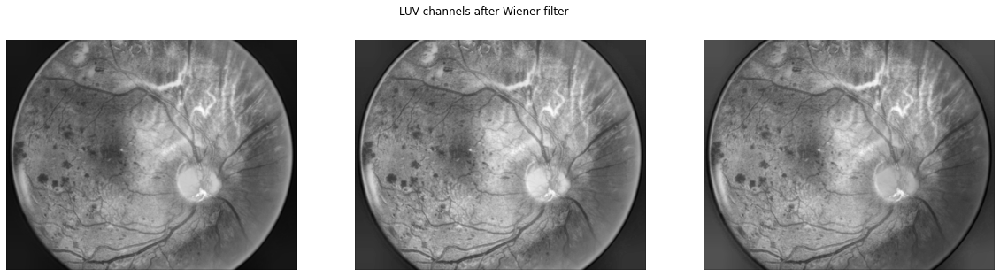

In [140]:
img_luv3 = sp.signal.wiener(img_luv2, noise=10.0)
normalize_image(img_luv3)
plot_subfigures([img_luv3[:, :, i] for i in range(3)], 
                'LUV channels after Wiener filter', fig_size=(20, 5))

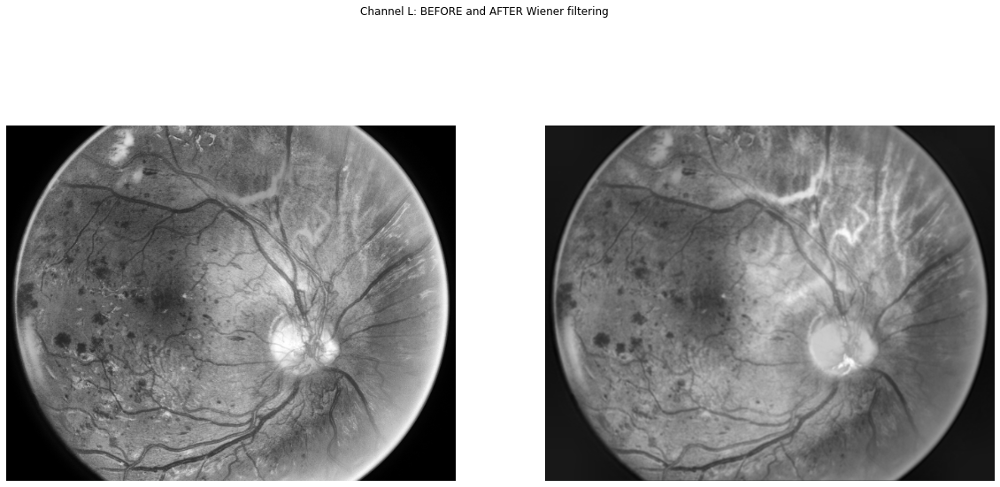

In [141]:
plot_subfigures(np.array([img_luv2[:, :, 0], img_luv3[:, :, 0]]), fig_size=(20, 10), 
                title='Channel L: BEFORE and AFTER Wiener filtering')

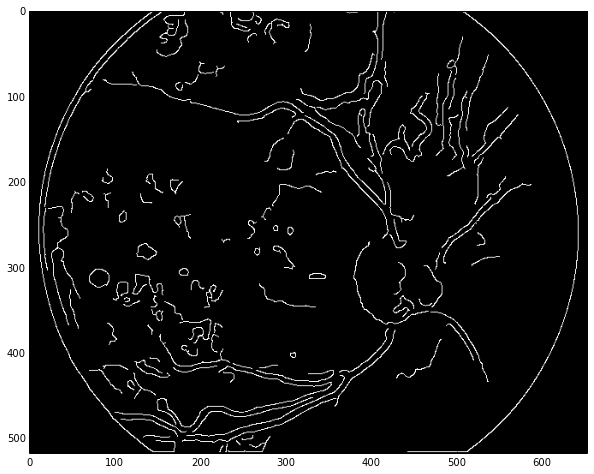

In [142]:
edges = skimage.feature.canny(img_luv3[:, :, 1], sigma=2.0)
show_image(edges)

In [143]:
import retina_im_lib; reload(retina_im_lib)
from retina_im_lib import *

tol1, tol2, tol3 = 100, 40, 100
# 20, 30, 30
# 100, 40, 100
img_obj_map = region_growing_1(img_luv3[:, :, 1] * 255.0, radius=3, edges=edges,
                               tol1=tol1, tol2=tol2, tol3=tol3)

255

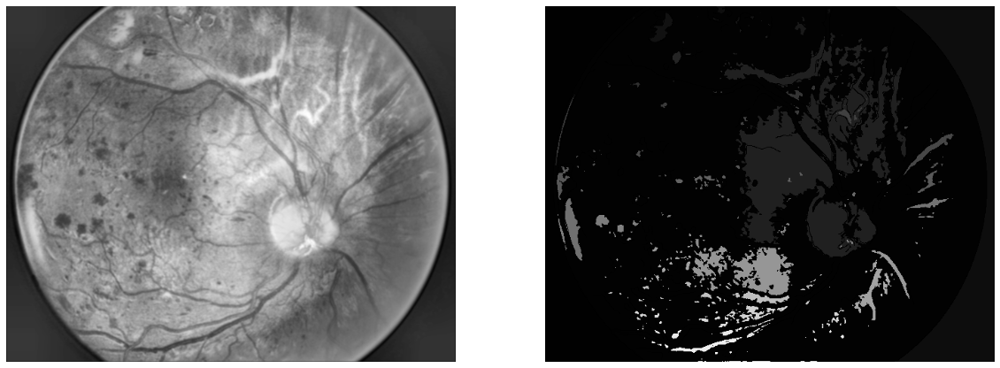

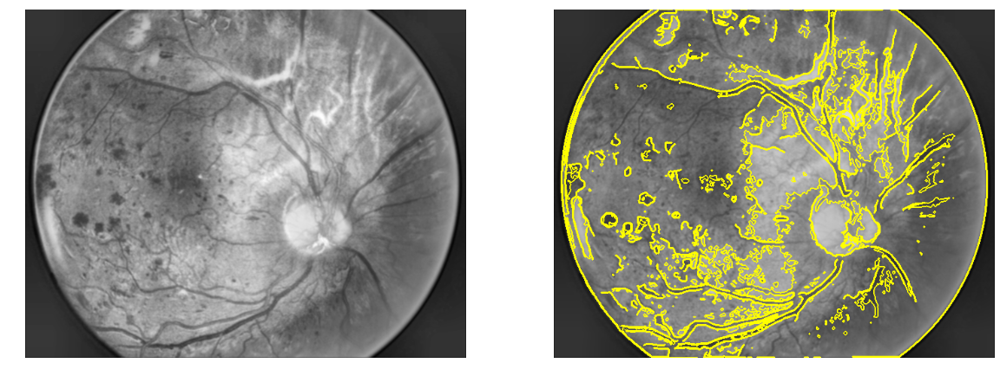

In [144]:
plot_subfigures([img_luv3[:, :, 1], img_obj_map], fig_size=(20, 10))

fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(img_luv3[:, :, 1])
ax[0].axis('off')
ax[1].imshow(skimage.segmentation.mark_boundaries(img_luv3[:, :, 1], img_obj_map))
ax[1].axis('off')
#plot_subfigures([img_luv3[:, :, 1], skimage.segmentation.mark_boundaries(img_luv3[:, :, 1], img_obj_map)],
#                fig_size=(20, 10))

img_obj_map.max()

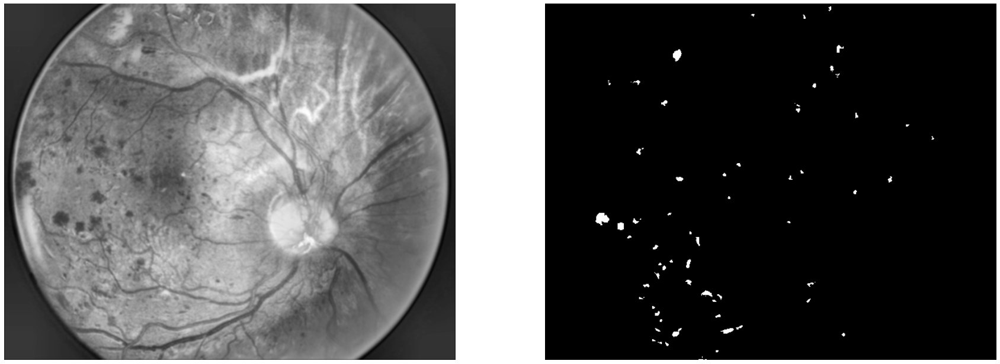

In [146]:
import cluster_features
reload(cluster_features)
from cluster_features import *

segm_to_leave = list(np.where((cl_circularity(img_obj_map) > 0.05) & \
                              (cl_areas(img_obj_map) > 10) & \
                              (cl_areas(img_obj_map) < 1000) & \
                              (cl_eccentricity(img_obj_map) > 0.1))[0])
                              #(cl_mean_intensity(img_obj_map, img_luv3[:, :, 1]) < 20))[0])

exud1 = leave_segments(img_obj_map, segm_to_leave, replace_value=-1)
plot_subfigures([img_luv3[:, :, 1], exud1 != -1], fig_size=(30, 15))

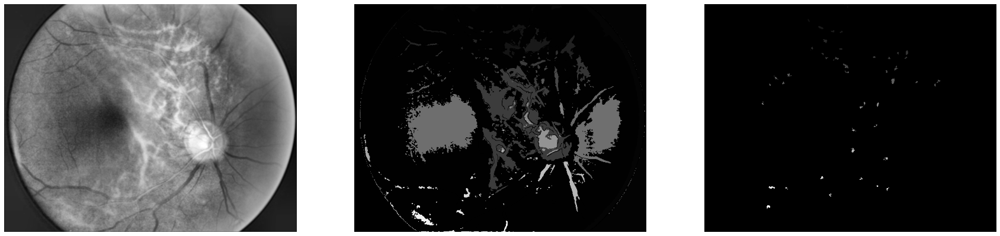

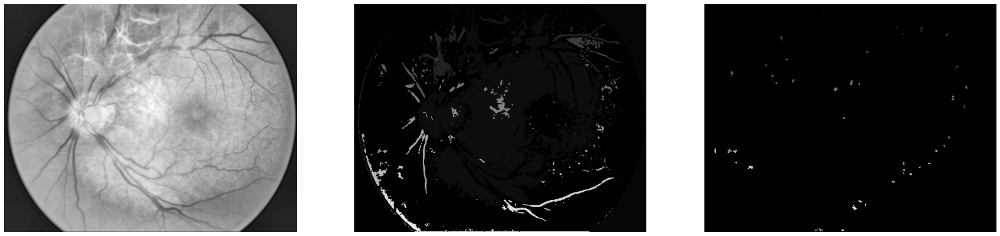

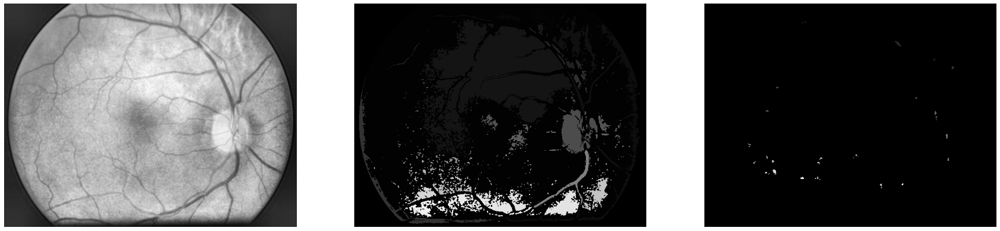

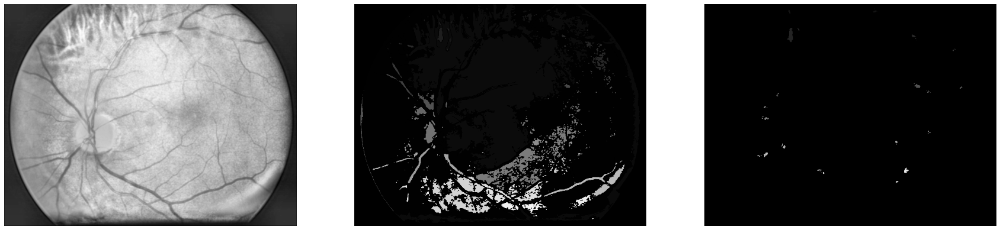

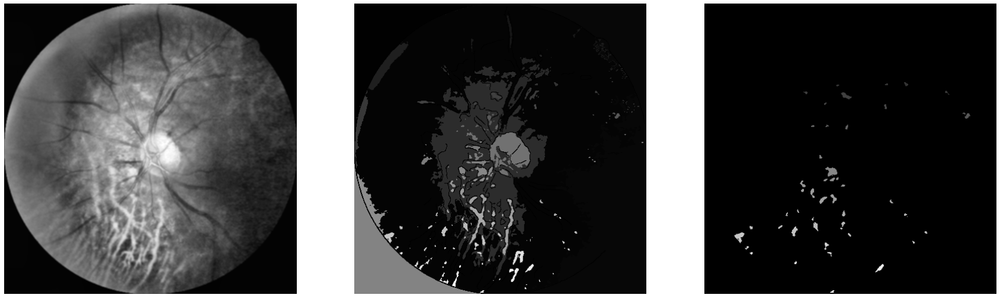

...

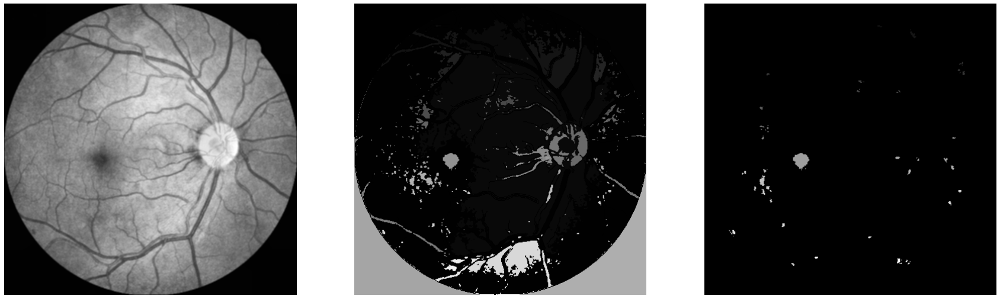

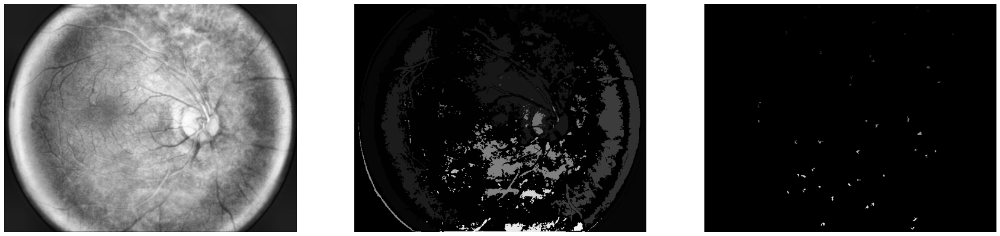

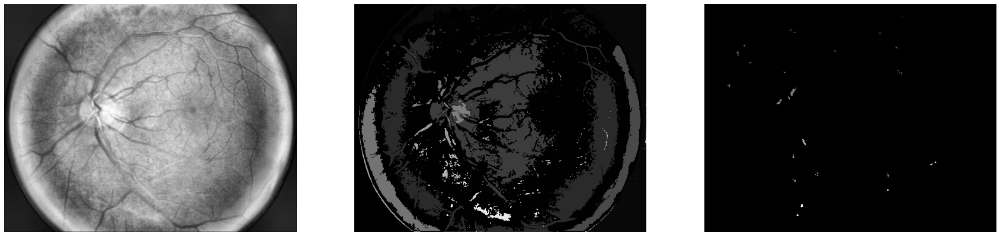

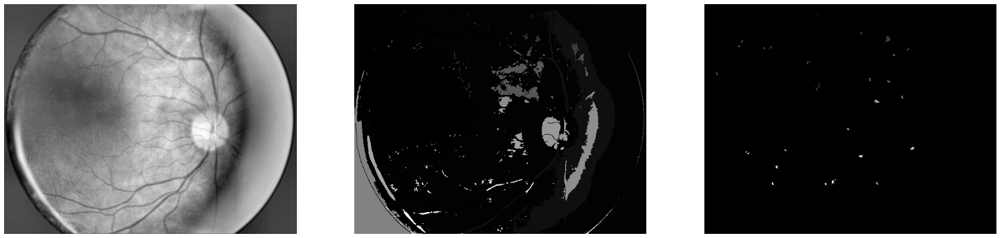

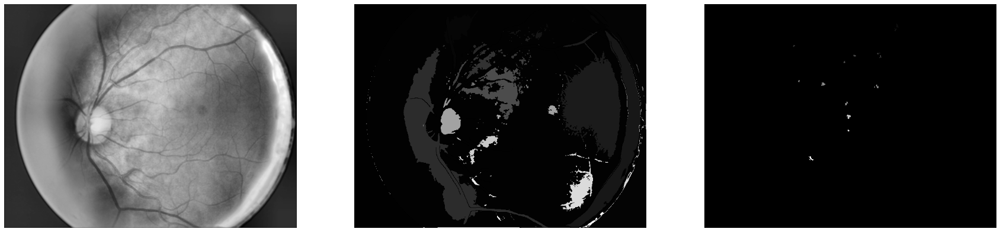

In [147]:
folder = '../data/disk_fit'   # using the same set of images as for disk 
                              # since they have almost equal lightness

for img_name in image_names_in_folder(folder):
    img = load_image(img_name)
    img = sp.misc.imresize(img, (518, 777))
    img = crop_black_border(img)
    
    img_luv = skimage.color.rgb2luv(img)
    img_luv = normalize_image(img_luv)
    img_luv2 = skimage.exposure.equalize_adapthist(img_luv)
    img_luv2 = normalize_image(img_luv2)
    img_luv3 = sp.signal.wiener(img_luv2, noise=10.0)
    img_luv3 = normalize_image(img_luv3)
    edges = skimage.feature.canny(img_luv3[:, :, 1], sigma=2.0)
    tol1, tol2, tol3 = 100, 40, 100
    img_obj_map = region_growing_1(img_luv3[:, :, 1] * 255, radius=3, edges=edges,
                                   tol1=tol1, tol2=tol2, tol3=tol3)
    segm_to_leave = list(np.where((cl_circularity(img_obj_map) > 0.05) & \
                              (cl_areas(img_obj_map) > 10) & \
                              (cl_areas(img_obj_map) < 1000) & \
                              (cl_eccentricity(img_obj_map) > 0.1))[0])
                              #(cl_mean_intensity(img_obj_map, img_luv3[:, :, 1]) < 20))[0])
    exud1 = leave_segments(img_obj_map, segm_to_leave, \
                           replace_value=-1)
    _ = plt.figure()
    plot_subfigures([img_luv3[:, :, 1], img_obj_map, exud1], fig_size=(30, 10))
    plt.show()

Видны дефекты сегментации, например, оптический диск и темное пятно иногда остаются после сегментации в виде больших участков. При этом для больных глаз распознается больше элементов, чем для здоровых.

### Выделение оптического диска (белого пятна)

Ниже реализован метод выделения оптического диска из статьи **Huiqi Li «Automated Feature Extraction in Color Retinal Images by a Model Based Approach»**. Схема метода:
1. На изображении оставляют только 3% самых ярких пикселей (в другой модификации статьи &mdash; 1%).
2. Изображение разбивается на кластеры алгоритмом region growing.
3. Кластеры помещаются в прямоугольники и приводятся к некоторому размеру N x N.
4. Аналогичная процедура проводится для набора изображений, собирается большое количество квадратов с кластерами различной формы.
5. Чтобы извлечь информацию о часто встречающихся формах кластеров, проводится преобразование PCA с уменьшением размерности. Извлекается несколько собственных векторов (в статье - "собственных дисков"). Вводится метрика схожести кластера с "шаблоном", созданным с помощью PCA, неподходящие кластеры отсекаются по значению данной метрики.

http://www-prima.inrialpes.fr/perso/Tran/ICCV03-Proceedings/ICCV/iccv03/0394_li.pdf

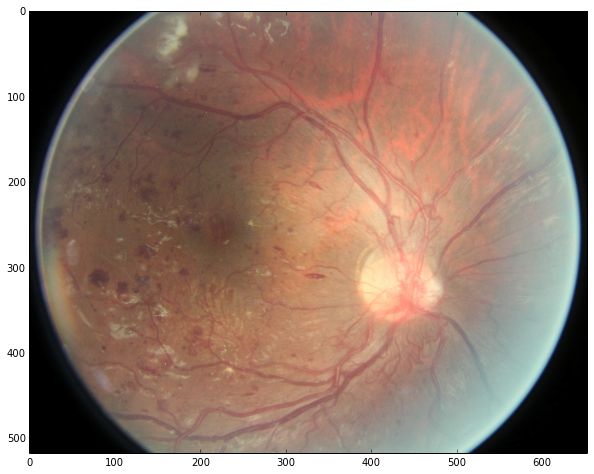

In [110]:
show_image(img)

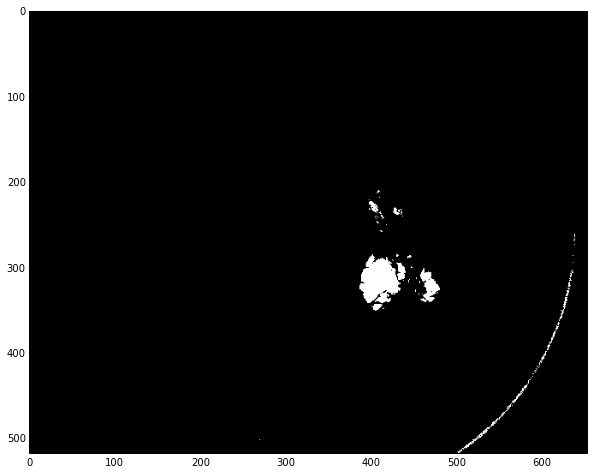

In [111]:
t = np.percentile(gb.ravel(), 99)
bright = gb > t
bright = (bright * 255).astype(int)
show_image(bright)

CPU times: user 30.1 s, sys: 24 ms, total: 30.1 s
Wall time: 30.3 s


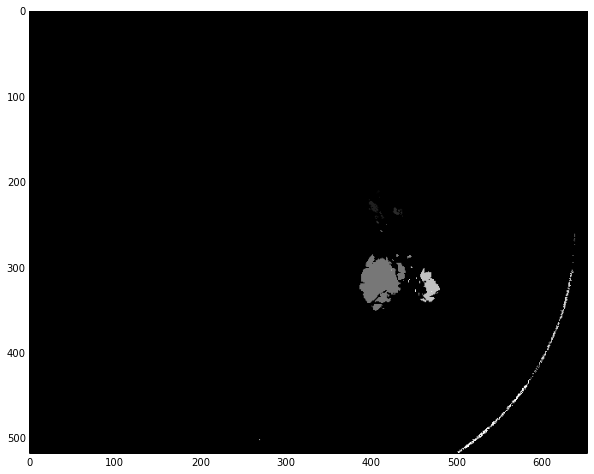

In [112]:
%time cl1 = bfs_clustered(bright, radius=2, tol=1)
show_image(cl1)

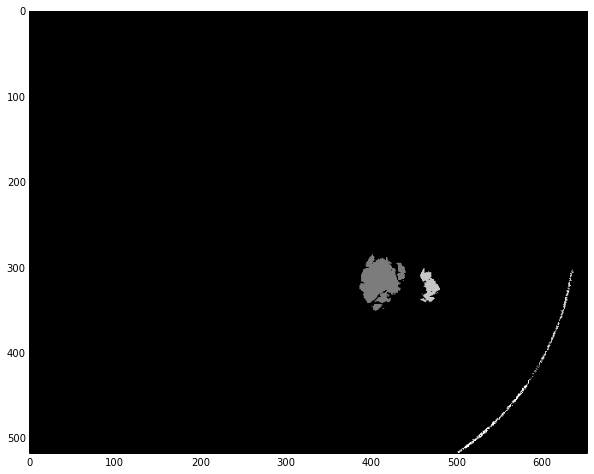

In [113]:
cl2 = erase_clusters(cl1, small_tol=0.0004 * cl1.shape[0] * cl1.shape[1],
                     large_tol=2 * cl1.size, small_replace=0)
show_image(cl2)

In [114]:
box_shape = 30
cl_boxes, _ = get_clusters(cl2, box_shape=box_shape)
cl_boxes = cl_boxes[1:]    # ignoring background
cl_boxes = cl_boxes[cl_boxes.mean(axis=1) != 0.0]

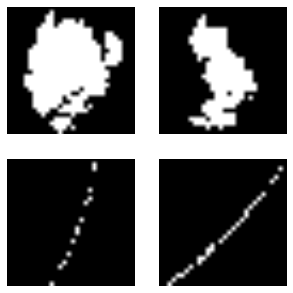

In [115]:
def find_greatest_divisor(n):
    m = int(sqrt(n))
    while n % m != 0:
        m -= 1
    return m

n_boxes = cl_boxes.shape[0]
boxes_on_side = find_greatest_divisor(n_boxes)
plot_boxes = cl_boxes.reshape((boxes_on_side, n_boxes / boxes_on_side, box_shape, box_shape))
plot_subfigures(plot_boxes, fig_size=(5, 5))

In [118]:
pca = sklearn.decomposition.PCA(n_components=2)
boxes_pca = pca.fit_transform(cl_boxes)

In [119]:
print 'Variance explained by data with reduced dimensionality: ', \
    pca.explained_variance_ratio_.sum()

Variance explained by data with reduced dimensionality:  0.945999786236


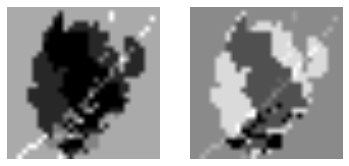

In [120]:
plot_subfigures(pca.components_.reshape((pca.components_.shape[0],
                                         box_shape, box_shape)))

In [121]:
cl_boxes_all = get_clusters_from_img_set('../data/sample')

KeyboardInterrupt: 

In [ ]:
pca = sklearn.decomposition.PCA(n_components=30)
boxes_pca = pca.fit_transform(cl_boxes_all)
print 'Variance explained by data with reduced dimensionality: ', \
    pca.explained_variance_ratio_.sum()

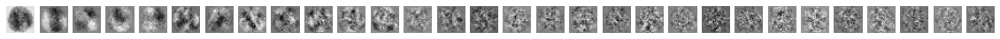

In [78]:
plot_subfigures(pca.components_.reshape((pca.components_.shape[0],
                                         box_shape, box_shape)), fig_size=(20, 20))

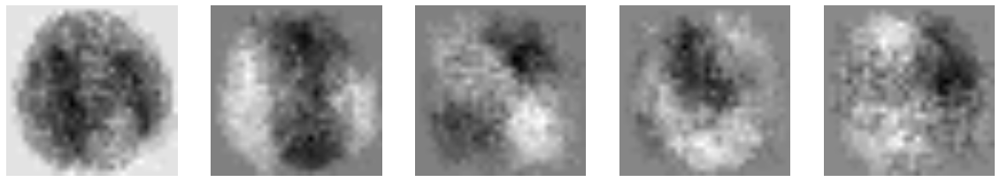

In [79]:
plot_subfigures(pca.components_[:5].reshape((pca.components_[:5].shape[0],
                                         box_shape, box_shape)), fig_size=(20, 20))

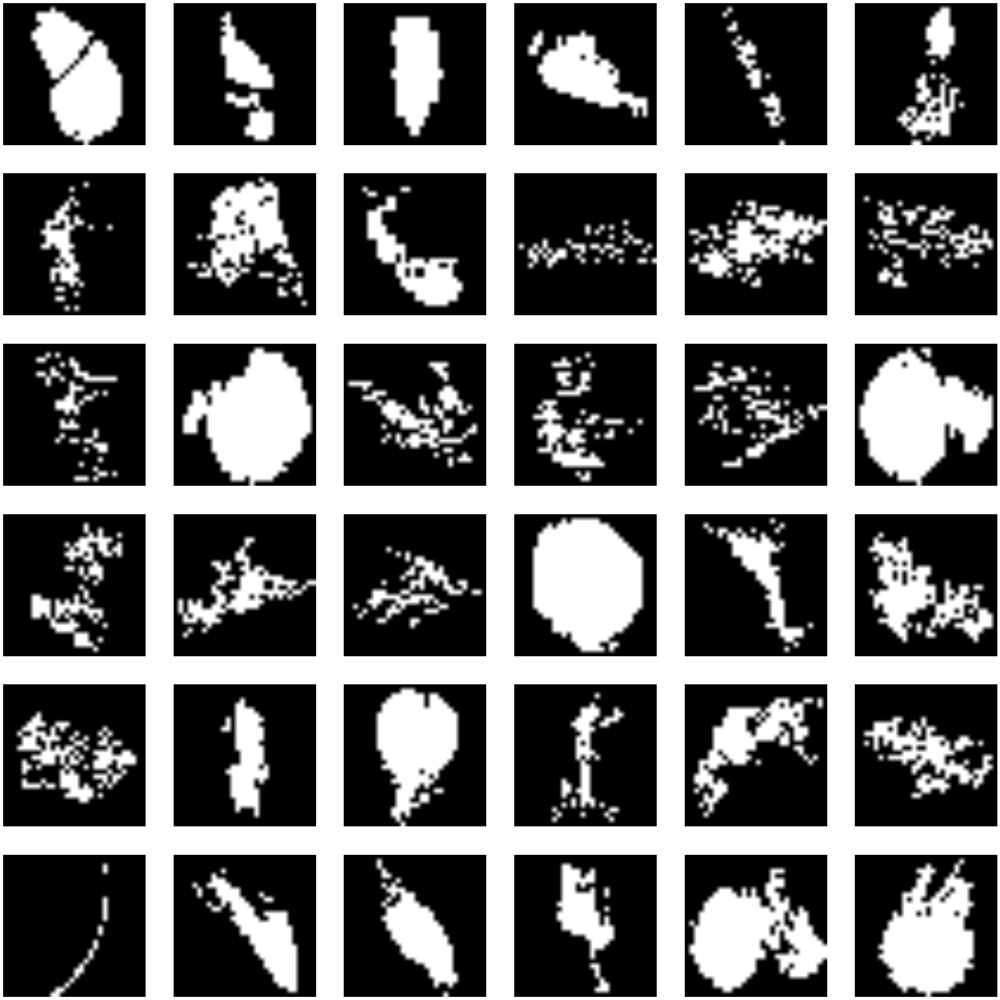

In [80]:
plot_subfigures(cl_boxes_all[:36].reshape((6, 6, box_shape, box_shape)), 
                fig_size=(40, 40))

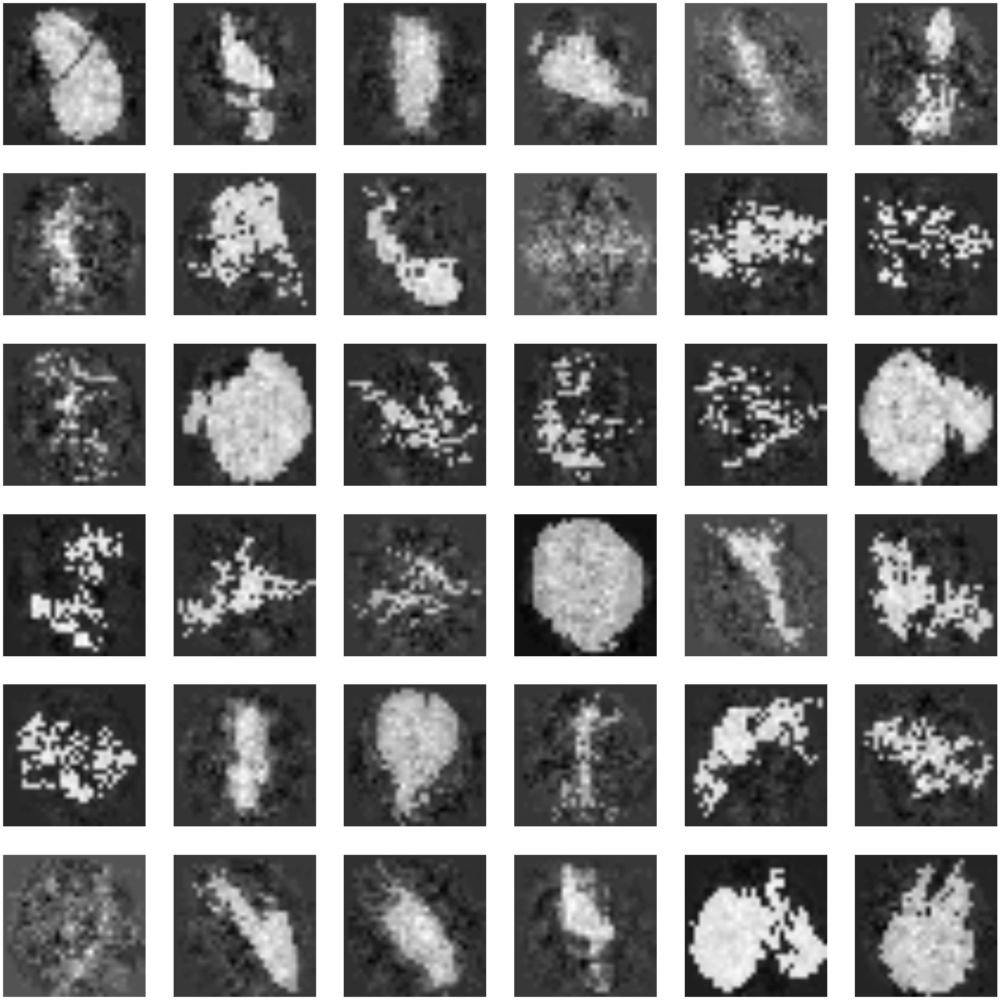

In [93]:
rec = pca.inverse_transform(pca.transform(cl_boxes_all))
plot_subfigures(rec[:36].reshape((6, 6, box_shape, box_shape)), fig_size=(40, 40))

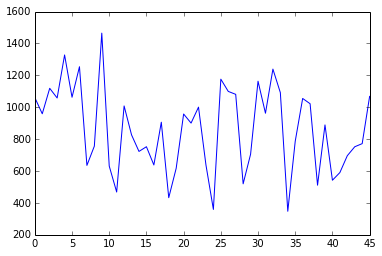

In [94]:
pca_error = np.linalg.norm(cl_boxes_all - rec, axis=1)
plt.plot(pca_error)

Error threshold:  700.742861621


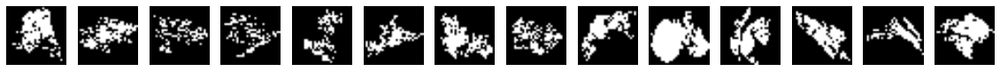

In [95]:
thr = np.percentile(pca_error, 30)
print 'Error threshold: ', thr
low_error_boxes = cl_boxes_all[pca_error < thr]
plot_subfigures(low_error_boxes.reshape(low_error_boxes.shape[0], box_shape, box_shape), 
                fig_size=(20, 20))

In [96]:
box_shape = 30
boxes, cl_no = get_clusters(cl2, box_shape)
cl_num = cl1.max() + 1
rec = pca.inverse_transform(pca.transform(boxes))
pca_error = np.linalg.norm(boxes - rec, axis=1)
thr = np.percentile(pca_error, 50)
cl_no = np.array(cl_no)
cl_to_leave = cl_no[pca_error < thr]
if 0 not in cl_to_leave:
    cl_to_leave = np.hstack((0, cl_to_leave))
cl3 = leave_segments(cl2, cl_to_leave)

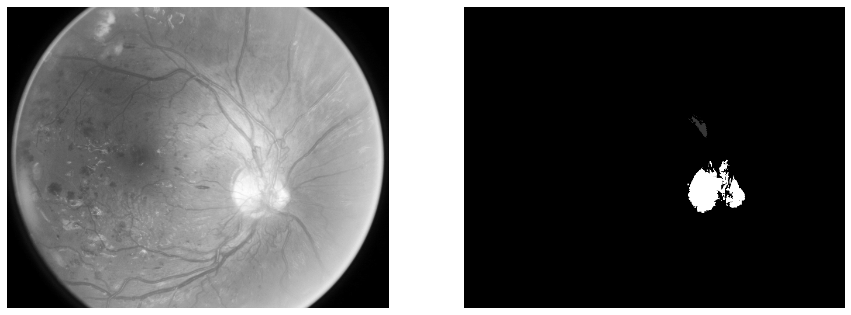

In [97]:
compare_imgs = np.empty((2, gb.shape[0], gb.shape[1]))
compare_imgs[0] = gb
compare_imgs[1] = cl3
plot_subfigures(compare_imgs, fig_size=(15, 15))

Выделение оптического диска позволяет убрать его с карты поражений глаза и не перепутать его с поражениями глаза.

Проверка на разных изображениях:

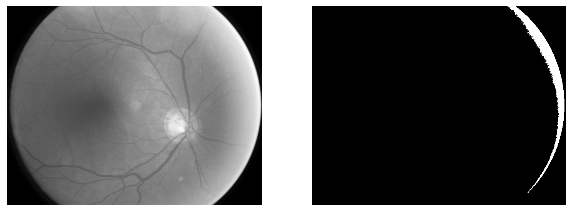

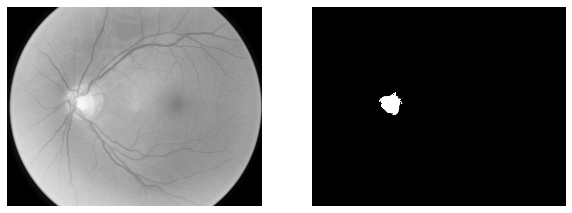

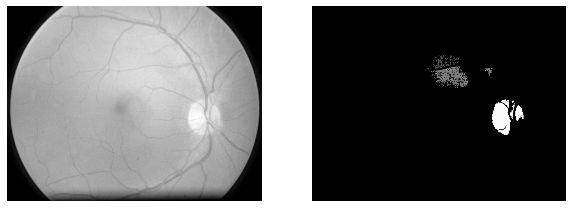

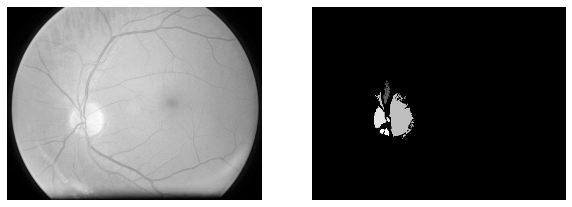

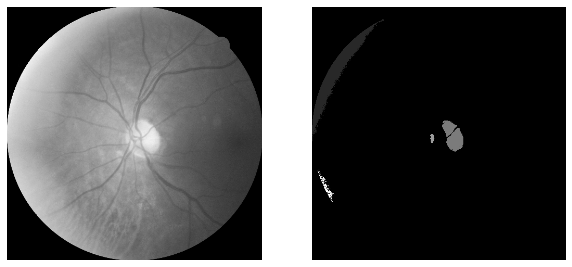

...

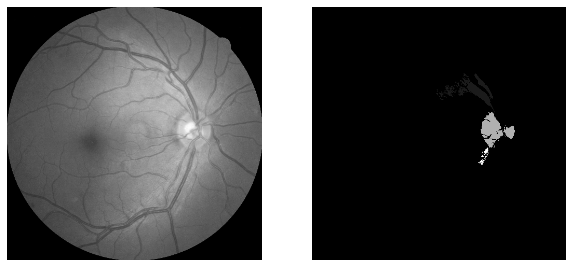

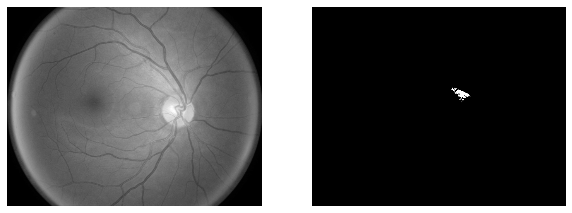

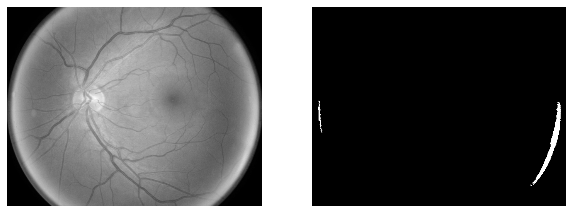

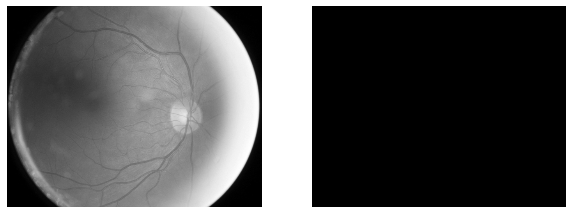

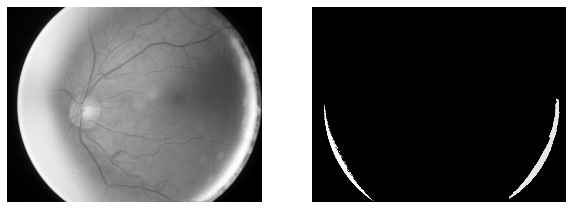

In [103]:
for img_name in image_names_in_folder(folder_disks):
    img = load_image(img_name)
    gb = prepare_img(img)
    
    img_disk = optic_disk_detect(gb, pca, box_shape)
    plt.figure()
    plot_subfigures([gb, img_disk], fig_size=(10, 10))

In [102]:
import objects_detection, retina_im_lib
reload(objects_detection); reload(retina_im_lib)
from objects_detection import *
from retina

folder_disks = '../data/disk_fit'
box_shape = 30
%time pca = optic_disk_fit(folder_disks, n_pca_compns=6, box_shape=box_shape)

CPU times: user 12min 59s, sys: 1min 8s, total: 14min 7s
Wall time: 15min 18s
